<a href="https://colab.research.google.com/github/deepakshekhawat1209/mobile_price_range_prediction/blob/main/Classification_Machine_learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Name**    - 'Mobile Price Range Prediction'



##### **Project Type**    - Classification
##### **Contribution**    - Individual
##### **Team Member  -** Deepak


# **Project Summary -**

Started the project with data loading,then looked into description of data through various pandas function.After that I did EDA to see some beautiful insights and the relationship between the variables using heatmap. Some of insights,I am mentioning here-

1) There is a gradual increase in battery as the price range increases

2) Ram has continuous increase with price range while moving from Low cost to Very high cost

3) Costly phones are lighter

4) RAM, battery power, pixels played more significant role in deciding the price range of mobile phone.

for more insights,just have a look into the project.After EDA, check the muticollinearity and important feautures for the model,some operations are performed over variables with high VIF value and selected the useful features for the machine learning model.Then scaled the data using min max scaler and split data into train and test.After splitting applied various machine learning model-

1) Logistic Regression

2)Decision Tree Classifier

3) Random Forest Classifier

4)XGB Classifier

5)K-Neighbours Classifier

6)Gaussian Naves Bias

7)Support Vector Classifier

After applied these various models along with the application of hyper tuning,got the best model.I evaluated the performance on the basis of accuracy score and used the explainability tool using LIME for the best model.

Conclusion:
I choosed Logistic regresson with hyper tunning to be the best machine learning model out of other models as it gives the high accuracy score for both training data and testing data. If i talk about its accuracy percentage then its training accuracy score is found to be 95.625% and its testing accuracy score to be 94%.

# **GitHub Link -**

https://github.com/deepakshekhawat1209/mobile_price_range_prediction/

# **Problem Statement**


#In the competitive mobile phone market companies want to understand sales data of mobile phones and factors which drive the prices. The objective is to find out some relation between features of a mobile phone(eg:- RAM, Internal Memory, etc) and its selling price. In this problem, we do not have to predict the actual price but a price range indicating how high the price is.

# ***Let's Begin !***

## ***1. Know Your Data***

### Import Libraries

In [84]:
# Importing Libraries:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, confusion_matrix, accuracy_score,precision_score,recall_score,f1_score
from sklearn.linear_model import LogisticRegression
#importing warning
from warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
simplefilter("ignore", category=ConvergenceWarning)
#import grid search cv
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.svm import SVC
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import reciprocal, uniform

### Dataset Loading

In [85]:
# Mounting the drive:
from google.colab import drive 
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [86]:
# Load Dataset
data=pd.read_csv('/content/drive/MyDrive/AlmaBetter/modules/machine learning/capstone project/classification/Copy of data_mobile_price_range.csv')

In [87]:
df=data.copy()
df.head(1)

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1


### Dataset First View

In [88]:
# Dataset First Look
data.head(5)

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1


### Dataset Rows & Columns count

In [89]:
# Dataset Rows & Columns count
data.shape

(2000, 21)

### Dataset Information

In [90]:
# Dataset Info
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

#### Duplicate Values

In [91]:
# Dataset Duplicate Value Count
data.duplicated().value_counts()

False    2000
dtype: int64

#### Missing Values/Null Values

In [92]:
# Missing Values/Null Values Count
data.isna().sum()

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
sc_w             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
price_range      0
dtype: int64

In [93]:
# Visualizing the missing values
import missingno as msno

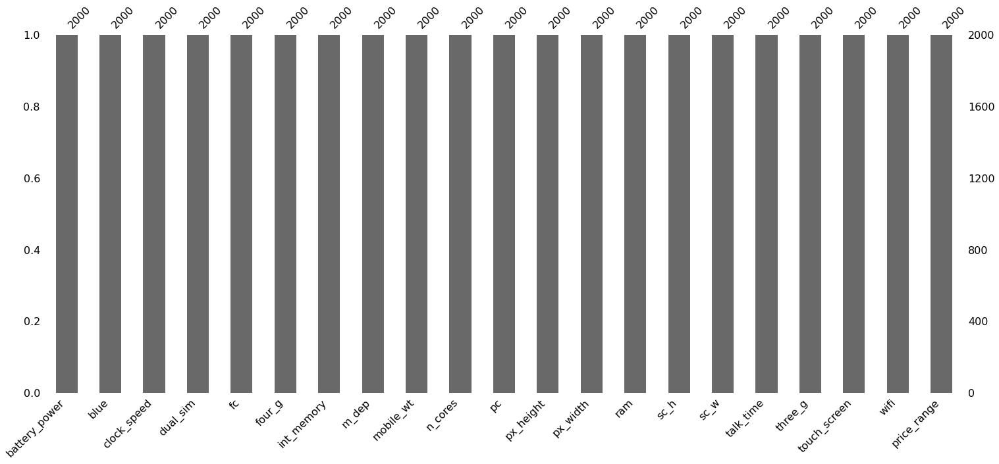

In [94]:
#bar form
msno.bar(data)

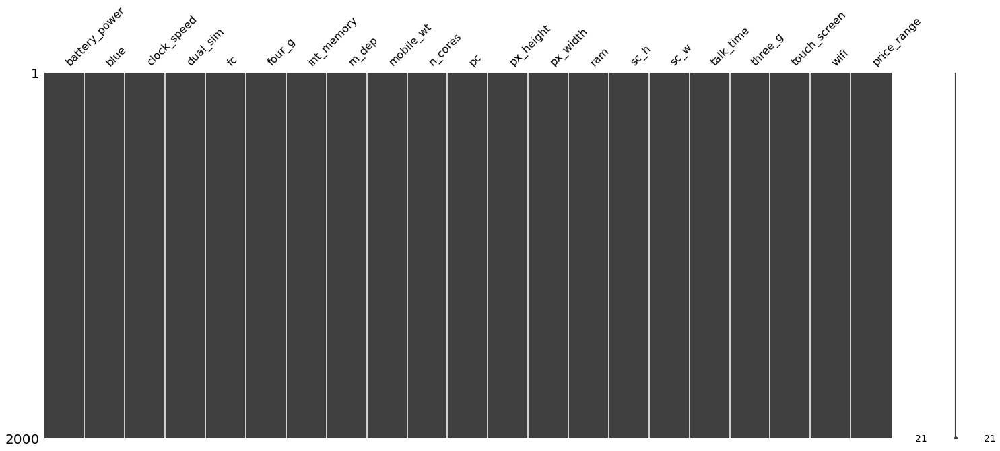

In [95]:
#matrix form
msno.matrix(data)

### What did you know about your dataset?

The dataset is having 21 Features(columns) and 2000 values(rows). 
There is no duplicacy seen in the dataset.
Dataset doesn't have any null value and it is cleared from the above visualizion- bar plot and matrix plot.In barplot, all features are having the same bar height and in matrix plot, the whole plot is black, this shows that no null values are present in the dataset.

## ***2. Understanding Your Variables***

In [96]:
# Dataset Columns
data.columns

Index(['battery_power', 'blue', 'clock_speed', 'dual_sim', 'fc', 'four_g',
       'int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'px_height',
       'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time', 'three_g',
       'touch_screen', 'wifi', 'price_range'],
      dtype='object')

In [97]:
# Dataset Describe
data.describe()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,...,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,...,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,...,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,...,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,...,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,...,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,...,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,...,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


### Variables Description 

#1) **battery_power** : Total energy measured in mAh, a battery can store in one time.
#2) **blue** : Whether it Has bluetooth or not.
#3) **clock_speed** : speed at which microprocessor executes instructions.
#4) **dual _sim** : Whether it Has dual sim support or not.
#5) **fc** : megapixels of Front Camera.
#6) **four_g** : Whether it Has 4G or not.
#7)**int_memory** : Internal Memory in Gigabytes.
#8) **m_dep** : Mobile Depth in cm.
#9) **mobile_wt** : Weight of mobile phone.
#10) **n_cores** : Number of cores of processor.
#11) **pc** : megapixels of Primary Camera.
#12) **px_height** : Pixel Resolution Height.
#13) **px_width** : Pixel Resolution Width.
#14) **ram** : Random Access Memory in Megabytes.
#15) **sc_h** : Screen Height of mobile in cm.
#16) **sc_w** : Screen Width of mobile in cm.
#17) **talk_time** : longest time that a battery will last after single charge.
#18) **three_g** : Whether Has 3G or not.
#19) **touch_screen** : Whether it Has touch screen or not.
#20) **wifi** : Whether it Has wifi or not.
#21) **price_range** : This is the target variable with values of 0(low cost), 1(medium cost), 2(high cost) and 3(very high cost).



### Check Unique Values for each variable.

In [98]:
# Check Unique Values for each variable.
data.nunique()

battery_power    1094
blue                2
clock_speed        26
dual_sim            2
fc                 20
four_g              2
int_memory         63
m_dep              10
mobile_wt         121
n_cores             8
pc                 21
px_height        1137
px_width         1109
ram              1562
sc_h               15
sc_w               19
talk_time          19
three_g             2
touch_screen        2
wifi                2
price_range         4
dtype: int64

## 3. ***Data Wrangling***

### Data Wrangling Code

In [99]:
#code to make dataset analysis ready.

data['px_height'].replace(to_replace=0,value=data['px_height'].median(),inplace=True)
data['sc_w'].replace(to_replace=0,value=data['sc_w'].mean(axis=0),inplace=True)



In [100]:
#columns transformation
data['Screen size']=round((np.sqrt((data['sc_h']**2) + (data['sc_w']**2)))/2.54,2)
data['pixel_resolution']=(data['px_height']*data['px_width'])/1000000

In [101]:
#dropping unnecessary columns
data.drop(columns=['px_height','px_width','sc_w','sc_h'],inplace=True)

In [102]:
#Have a look on descriptive form of data
data.describe().T

,count,mean,std,min,25%,50%,75%,max
battery_power,2000.0,1238.518500,439.418206,501.000000,851.750000,1226.000000,1615.250000,1998.000000
blue,2000.0,0.495000,0.500100,0.000000,0.000000,0.000000,1.000000,1.000000
clock_speed,2000.0,1.522250,0.816004,0.500000,0.700000,1.500000,2.200000,3.000000
dual_sim,2000.0,0.509500,0.500035,0.000000,0.000000,1.000000,1.000000,1.000000
fc,2000.0,4.309500,4.341444,0.000000,1.000000,3.000000,7.000000,19.000000
four_g,2000.0,0.521500,0.499662,0.000000,0.000000,1.000000,1.000000,1.000000
int_memory,2000.0,32.046500,18.145715,2.000000,16.000000,32.000000,48.000000,64.000000
m_dep,2000.0,0.501750,0.288416,0.100000,0.200000,0.500000,0.800000,1.000000
mobile_wt,2000.0,140.249000,35.399655,80.000000,109.000000,141.000000,170.000000,200.000000
n_cores,2000.0,4.520500,2.287837,1.000000,3.000000,4.000000,7.000000,8.000000


### What all manipulations have you done and insights you found?

Since i found pixel height and screen width to be zero in the dataset but these two variables can not be zero so i have replaced their zero values with their median value(not affected by outliers).Also, there is some relation between pixel height and pixel width which is named as pixel resolution. so i create the pixel resolution column and drop the pixel width and pixel height columns. Moreover, there is some relation between screen height and screen width which is named as the Screen size. so i did the same, created Screen size column and dropped the screen width and screen height columns.

## ***4. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

#### Chart - 1

#Univariate Analysis

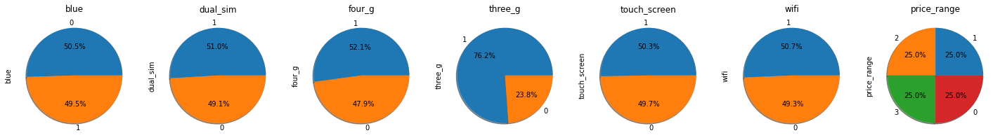

In [103]:
# Chart - 1 visualization code for categorical columns
categorical_columns=['blue','dual_sim','four_g','three_g','touch_screen','wifi','price_range']
plt.rcParams["figure.figsize"] = (25,6)
fig, ax = plt.subplots(1, len(categorical_columns))
for i, categorical_feature in enumerate(data[categorical_columns]):
  data[categorical_feature].value_counts().plot.pie(autopct='%1.1f%%',ax=ax[i],shadow=True).set_title(categorical_feature)
    #data[categorical_feature].value_counts().plot(kind="bar", ax=ax[i]).set_title(categorical_feature)
fig.show()


##### 1. Why did you pick the specific chart?

To visualize categorical column,pie chart can be used because it is very simple to understand and implement and one can conclude only by seeing the graph thats' why i have chosen this graph.

##### 2. What is/are the insight(s) found from the chart?

From above visualization, it is cleared that the categorical columns in our dataset are fully balanced except for the 3G column because in 3G column, it can be seen that most of the mobiles are 3G handset.

Our target feature-Price is also fully balanced which is a positive sign as we don't need to apply data imbalance techniques for this dataset.

#### Chart - 2

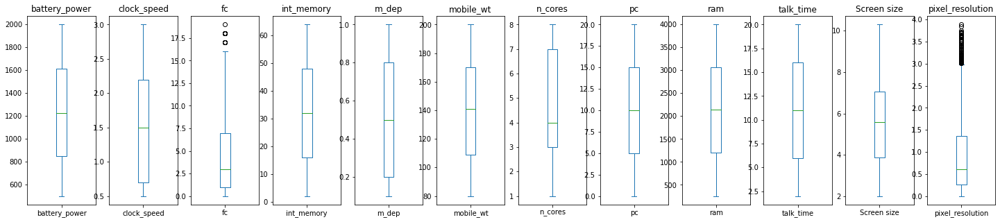

In [104]:
# Chart - 2 visualization code
numerical_columns=[col for col in data.columns if col not in categorical_columns]
plt.rcParams["figure.figsize"] = (25,5)
fig, ax = plt.subplots(1, len(numerical_columns))
for i, numerical_feature in enumerate(data[numerical_columns]):
    data[numerical_feature].plot(kind="box", ax=ax[i]).set_title(numerical_feature)
fig.show()


##### 1. Why did you pick the specific chart?

Boxplots are useful as they provide a visual summary of the data enabling researchers to quickly identify mean values, the dispersion of the data set, and signs of skewness.That's why boxplot is chosen here to know the data skewness and the presence of outliers or not.

##### 2. What is/are the insight(s) found from the chart?

From the above boxplots,In most of the plots, data is uniformally distributed but there are some plots also which are right skewed such as 'fc','pixel_resolution','n_cores' etc. Also Outliers are present in 'fc','pixel_resolution' columns.

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

Since outliers can be detected using boxplot at early stage before modelling or deployment of model,so we can remove outliers and can make highly accurate model for price prediction and thus helps in business growth.

#Bivariate Analysis

#### Chart - 3

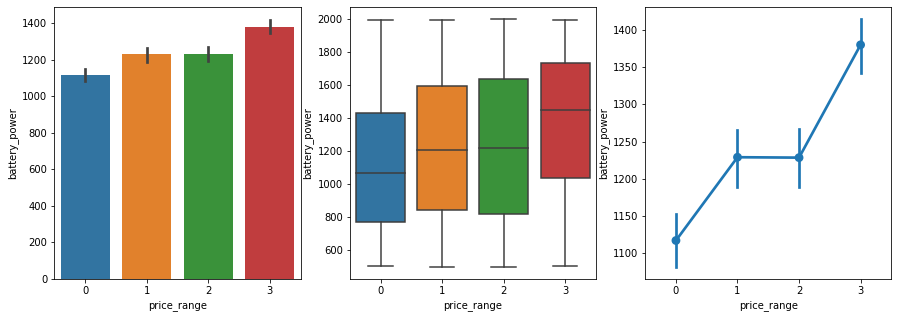

In [105]:
# Chart - 3 visualization code for the analysis of price_range vs battery_power
fig, axs = plt.subplots(1,3, figsize=(15,5))
sns.barplot(x='price_range',y='battery_power',data=data,ax=axs[0])
sns.boxplot(x='price_range',y='battery_power',data=data,ax=axs[1])
sns.pointplot(y="battery_power", x="price_range", data=data,ax=axs[2])


##### 1. Why did you pick the specific chart?

Used bargraph,boxplot and pointplot.

The bar graph helps to compare the different sets of data among different groups easily. It shows the relationship using two axes, in which the categories are on one axis and the discrete values are on the other axis. The graph shows the major changes in data over time.

Box plots are used to show distributions of numeric data values, especially when you want to compare them between multiple groups. They are built to provide high-level information at a glance, offering general information about a group of data's symmetry, skew, variance, and outliers.

A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.



##### 2. What is/are the insight(s) found from the chart?

From the visualization, it can be seen that there is a linear relation with battery power and the price,  the price is low for low battery mah and high price for the higher mah battery.

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

To gain high profit margin, company can use high mah battery into the mobile devices, as it is cleared from the above visualization that the customer can spend more money from his pocket if he found more power storage capacity in the handset.

#### Chart - 4

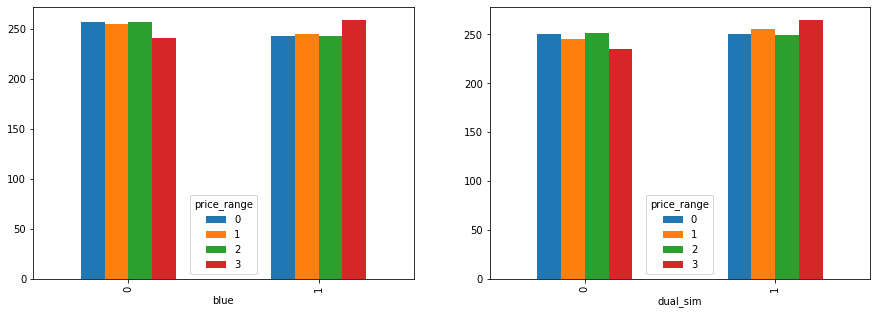

In [106]:
# Chart - 4 visualization code for bluetooth vs price_range and dual_sim vs price_range
fig, axs = plt.subplots(1,2, figsize=(15,5))
crosstab_result_1=pd.crosstab(index=data['blue'],columns=data['price_range'])
crosstab_result_1.plot.bar(ax=axs[0])
crosstab_result_2=pd.crosstab(index=data['dual_sim'],columns=data['price_range'])
crosstab_result_2.plot.bar(ax=axs[1])

##### 1. Why did you pick the specific chart?

Bar plot can also be used to plot the two categorical variables and result can be interpreted very easily.

##### 2. What is/are the insight(s) found from the chart?

From the visualization, we can see that if bluetooth and dual sim is not present, then the price is low and if they are present, then the price is high.

#### Chart - 5

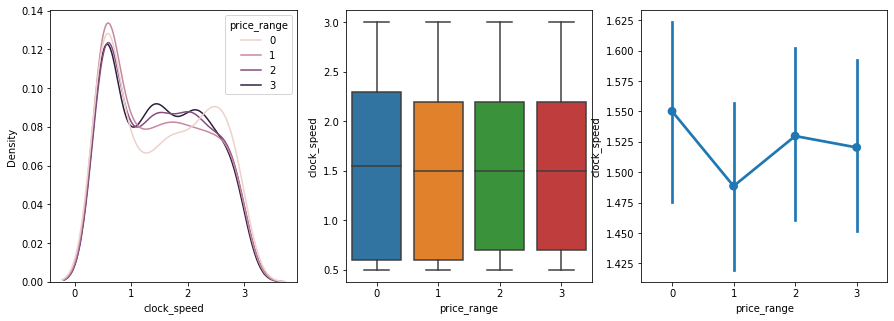

In [107]:
# Chart - 5 visualization code for clock_speed vs price_range
fig, axs = plt.subplots(1,3, figsize=(15,5))
sns.kdeplot(data=data, x='clock_speed', hue='price_range', ax=axs[0])
sns.boxplot(data=data, x='price_range', y='clock_speed', ax=axs[1])
sns.pointplot(y="clock_speed", x="price_range", data=data,ax=axs[2])
plt.show()

##### 1. Why did you pick the specific chart?

Used kdeplot boxplot and pointplot.

KDE is a way to estimate the probability density function of a continuous random variable. It is used when you need to know the distribution of the variable.

Box plots are used to show distributions of numeric data values, especially when you want to compare them between multiple groups. They are built to provide high-level information at a glance, offering general information about a group of data's symmetry, skew, variance, and outliers.

A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.

##### 2. What is/are the insight(s) found from the chart?

Generally,The clock speed determines how many instructions the processor can execute per second.The general rule is that higher clock speeds make for faster phones. You can often see this with more expensive smartphones.But from the graph,if the price of mobile is low, clock speed is high and if price is increased then clock speed seems to be decreased and another point if price is further increase,clock speed increase.So the general idea for clock speed is not much clear in the available data.

#### Chart - 6

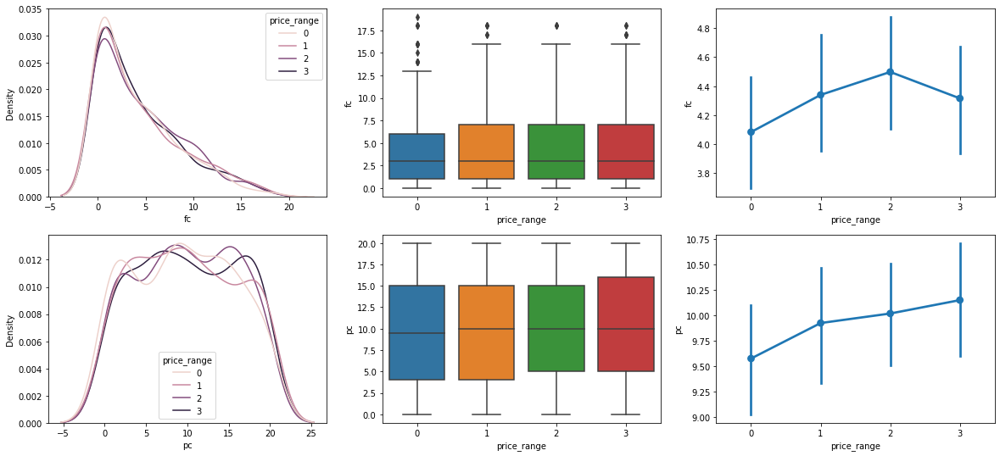

In [108]:
# Chart - 6 visualization code for front_camera vs price_range and rear_camera vs price_range

fig, axs = plt.subplots(2,3, figsize=(20,9))
sns.kdeplot(data=data, x='fc', hue='price_range', ax=axs[0][0])
sns.boxplot(data=data, x='price_range', y='fc', ax=axs[0][1])
sns.pointplot(y="fc", x="price_range", data=data,ax=axs[0][2])
sns.kdeplot(data=data, x='pc', hue='price_range', ax=axs[1][0])
sns.boxplot(data=data, x='price_range', y='pc', ax=axs[1][1])
sns.pointplot(y="pc", x="price_range", data=data,ax=axs[1][2])
plt.show()

Text(0.5, 0, 'MegaPixels')

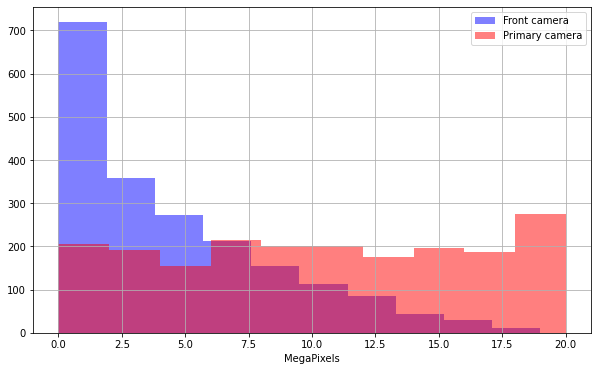

In [109]:
#Relation of front_camera,Rear_camera and the price_range
plt.figure(figsize=(10,6))
data['fc'].hist(alpha=0.5,color='blue',label='Front camera')
data['pc'].hist(alpha=0.5,color='red',label='Primary camera')
plt.legend()
plt.xlabel('MegaPixels')

##### 1. Why did you pick the specific chart?

Used kdeplot boxplot and pointplot.

KDE is a way to estimate the probability density function of a continuous random variable. It is used when you need to know the distribution of the variable.

Box plots are used to show distributions of numeric data values, especially when you want to compare them between multiple groups. They are built to provide high-level information at a glance, offering general information about a group of data's symmetry, skew, variance, and outliers.

A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.

##### 2. What is/are the insight(s) found from the chart?

We have seen the linear relation between rear camera and the price range, if megapixels of rear camera increases,price will increase and vice-versa. but in case of front camera,relation is linear upto a certain value after that on further increase in mobile price,the megapixels seems to be low.

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

If we increase the megapixels of both front and rear camera for medium cost mobile and sell them at high cost then this way we can earn some more money.  

#### Chart - 7

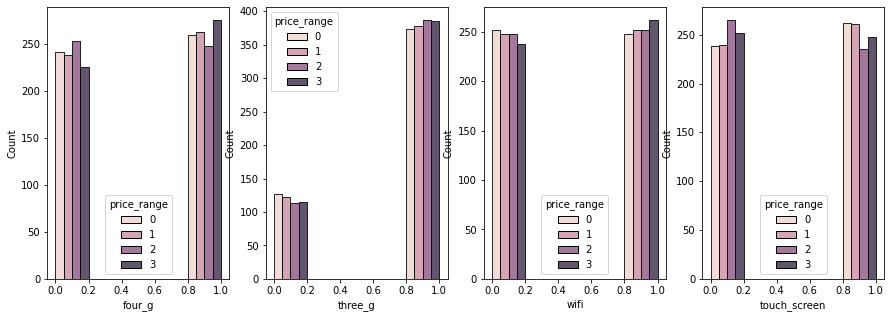

In [110]:
# Chart - 7 visualization code for relation of (four_g,three_g,wifi,touch_screen) vs price_range
fig, axs = plt.subplots(1,4, figsize=(15,5))
sns.histplot(binwidth=0.2, x="four_g", hue="price_range", data=data, stat="count", multiple="dodge",ax=axs[0])
sns.histplot(binwidth=0.2, x="three_g", hue="price_range", data=data, stat="count", multiple="dodge",ax=axs[1])
sns.histplot(binwidth=0.2, x="wifi", hue="price_range", data=data, stat="count", multiple="dodge",ax=axs[2])
sns.histplot(binwidth=0.2, x="touch_screen", hue="price_range", data=data, stat="count", multiple="dodge",ax=axs[3])

#Chart 8

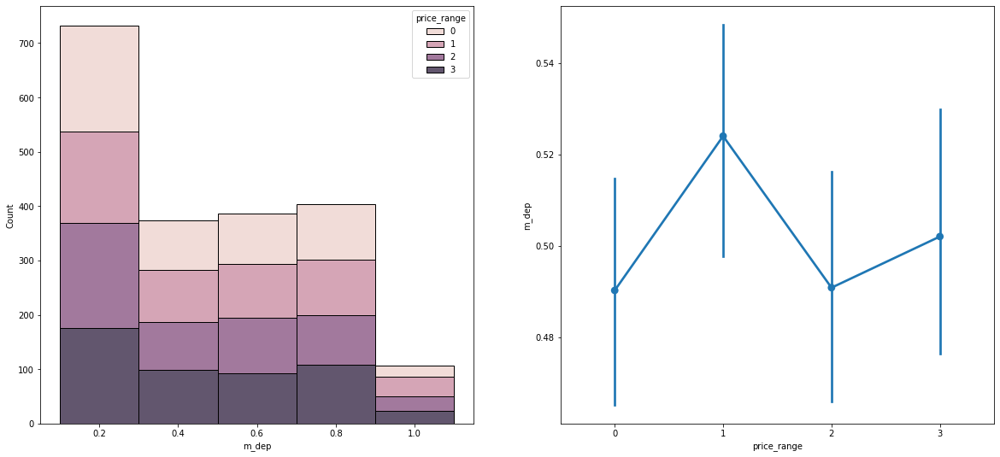

In [111]:
# Chart - 8 visualization code for mobile depth vs price_range
fig, axs = plt.subplots(1,2, figsize=(20,9))
sns.histplot(binwidth=0.2, x="m_dep", hue="price_range", data=data, stat="count", multiple="stack",ax=axs[0])
sns.pointplot(y="m_dep", x="price_range", data=data,ax=axs[1])
plt.show()

##### 1. Why did you pick the specific chart?

Used stacked bar chart and point plot

Stacked Bar charts are best used when showing comparisons between categories.


A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.

##### 2. What is/are the insight(s) found from the chart?

From visualisation, we can say that large depth of mobile will effect the mobile price in a negative way. or thicker the mobile,lower the price.

#### Chart - 9

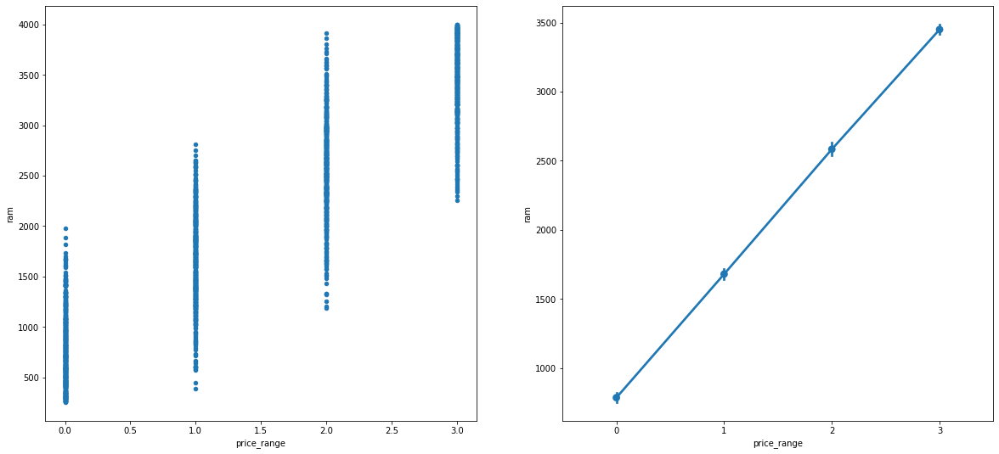

In [112]:
# Chart - 9 visualization code for ram vs price_range
fig, axs = plt.subplots(1,2, figsize=(20,9))
data.plot(x='price_range',y='ram',kind='scatter',ax=axs[0])
sns.pointplot(y="ram", x="price_range", data=data,ax=axs[1])
plt.show()

##### 1. Why did you pick the specific chart?

Used scatterplot and pointplot

A scatter plot is used to represent the values for two variables in a two-dimensional data-set.


A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.

##### 2. What is/are the insight(s) found from the chart?

Ram and mobile cost shows a linear relation i.e if ram of mobile increases then mobile get costly and otherwise if ram decrease.

#### Chart - 10

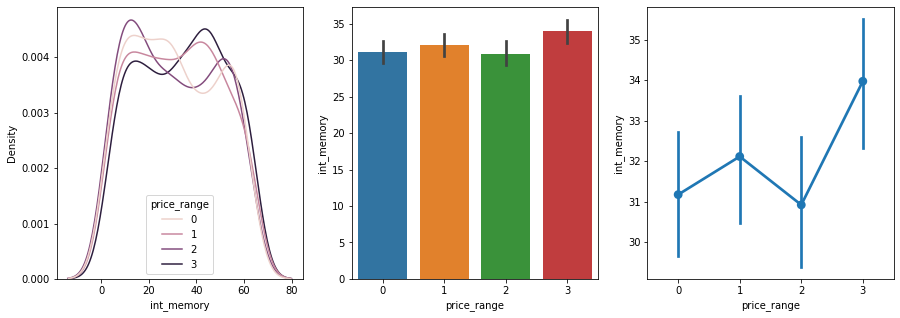

In [113]:
# Chart - 10 visualization code for internal_memory vs price_range
fig, axs = plt.subplots(1,3, figsize=(15,5))
sns.kdeplot(data=data, x='int_memory', hue='price_range', ax=axs[0])
sns.barplot(x='price_range',y='int_memory',data=data,ax=axs[1])
sns.pointplot(y="int_memory", x="price_range", data=data,ax=axs[2])
plt.show()

##### 1. Why did you pick the specific chart?

Used kdeplot barplot and pointplot.

KDE is a way to estimate the probability density function of a continuous random variable. It is used when you need to know the distribution of the variable.


The bar graph helps to compare the different sets of data among different groups easily. It shows the relationship using two axes, in which the categories are on one axis and the discrete values are on the other axis. The graph shows the major changes in data over time.

A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.

##### 2. What is/are the insight(s) found from the chart?

Larger the internal memory, higher will be the mobile cost and it can be seen if we compare the low cost mobile and high cost mobile with respect to the internal memory, internal memory is large for the high cost mobile than the low cost mobile.

#### Chart - 11

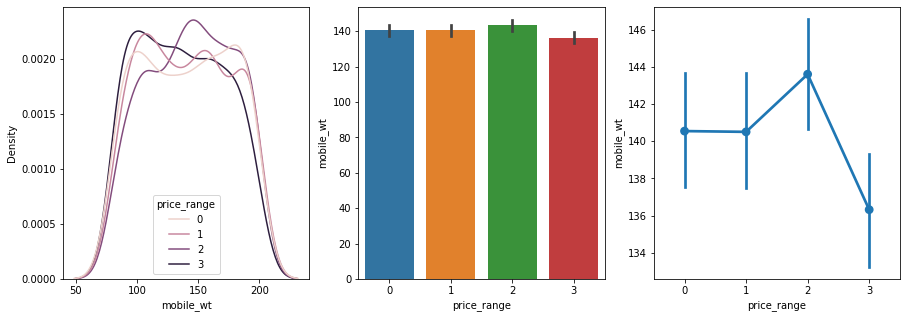

In [114]:
# Chart - 11 visualization code for mobile depth and the price_range
fig, axs = plt.subplots(1,3, figsize=(15,5))
sns.kdeplot(data=data, x='mobile_wt', hue='price_range', ax=axs[0])
sns.barplot(x='price_range',y='mobile_wt',data=data,ax=axs[1])
sns.pointplot(y="mobile_wt", x="price_range", data=data,ax=axs[2])
plt.show()


##### 1. Why did you pick the specific chart?

Used kdeplot barplot and pointplot.

KDE is a way to estimate the probability density function of a continuous random variable. It is used when you need to know the distribution of the variable.

The bar graph helps to compare the different sets of data among different groups easily. It shows the relationship using two axes, in which the categories are on one axis and the discrete values are on the other axis. The graph shows the major changes in data over time.

A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.

##### 2. What is/are the insight(s) found from the chart?

Costly mobile have lighter weight.

#### Chart - 12

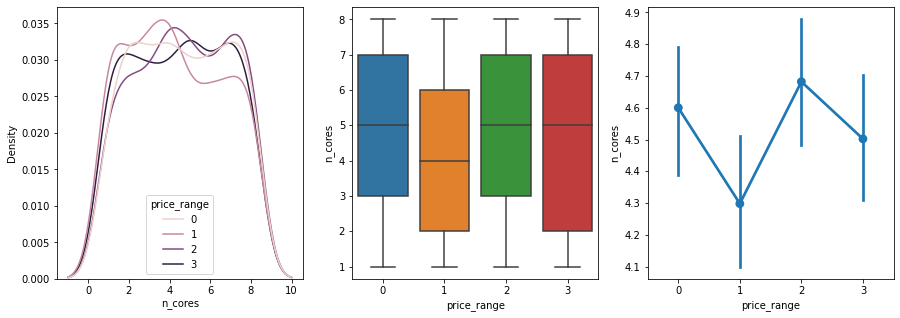

In [115]:
# Chart - 12 visualization code for numberof cores vs price_range
fig, axs = plt.subplots(1,3, figsize=(15,5))
sns.kdeplot(data=data, x='n_cores', hue='price_range', ax=axs[0])
sns.boxplot(x='price_range',y='n_cores',data=data,ax=axs[1])
sns.pointplot(y="n_cores", x="price_range", data=data,ax=axs[2])
plt.show()

##### 1. Why did you pick the specific chart?

Used kdeplot boxplot and pointplot.

KDE is a way to estimate the probability density function of a continuous random variable. It is used when you need to know the distribution of the variable.

Box plots are used to show distributions of numeric data values, especially when you want to compare them between multiple groups. They are built to provide high-level information at a glance, offering general information about a group of data's symmetry, skew, variance, and outliers.

A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.

##### 2. What is/are the insight(s) found from the chart?

Nothing clear can be interpreted from this visualisation, so lets move to further plots

#### Chart - 13

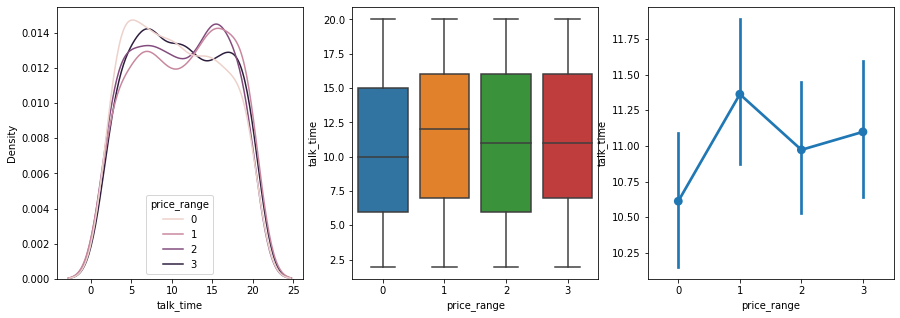

In [116]:
# Chart - 13 visualization code for talk time vs price range
fig, axs = plt.subplots(1,3, figsize=(15,5))
sns.kdeplot(data=data, x='talk_time', hue='price_range', ax=axs[0])
sns.boxplot(x='price_range',y='talk_time',data=data,ax=axs[1])
sns.pointplot(y="talk_time", x="price_range", data=data,ax=axs[2])
plt.show()

##### 1. Why did you pick the specific chart?

Used kdeplot boxplot and pointplot.

KDE is a way to estimate the probability density function of a continuous random variable. It is used when you need to know the distribution of the variable.

Box plots are used to show distributions of numeric data values, especially when you want to compare them between multiple groups. They are built to provide high-level information at a glance, offering general information about a group of data's symmetry, skew, variance, and outliers.

A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.

##### 2. What is/are the insight(s) found from the chart?

larger the talktime or if the time between two charging is large, then the cost of mobile will be high else the mobile cost is low.

#Chart 14

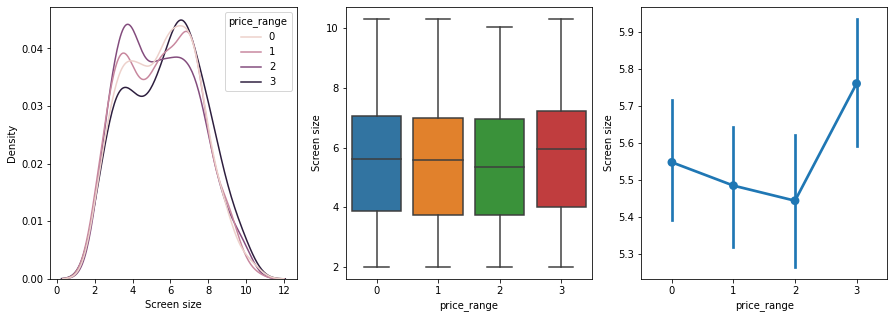

In [117]:
# Chart - 13 visualization code for screen size vs price range
fig, axs = plt.subplots(1,3, figsize=(15,5))
sns.kdeplot(data=data, x='Screen size', hue='price_range', ax=axs[0])
sns.boxplot(x='price_range',y='Screen size',data=data,ax=axs[1])
sns.pointplot(y="Screen size", x="price_range", data=data,ax=axs[2])
plt.show()

##### 1. Why did you pick the specific chart?

Used kdeplot boxplot and pointplot.

KDE is a way to estimate the probability density function of a continuous random variable. It is used when you need to know the distribution of the variable.

Box plots are used to show distributions of numeric data values, especially when you want to compare them between multiple groups. They are built to provide high-level information at a glance, offering general information about a group of data's symmetry, skew, variance, and outliers.

A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.

##### 2. What is/are the insight(s) found from the chart?

Generally it can be good to say that larger the screen size,higher will be the price. But if we talk about our current scenerio,it is seen that upto the high cost mobile, low screen size is preferred but for high cost mobile phone, larger screen size preferred.

#Chart 15

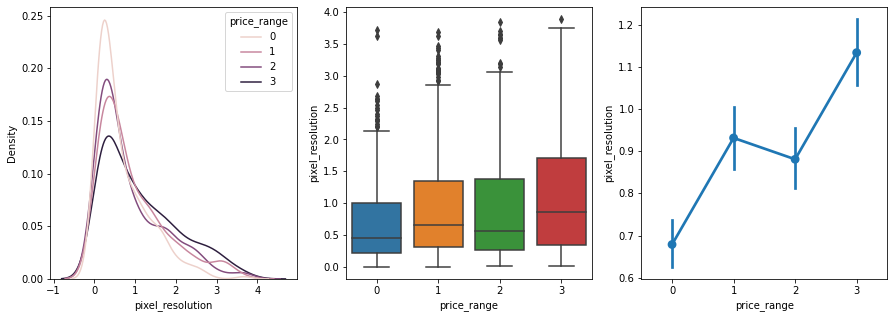

In [118]:
# Chart - 13 visualization code for pixel_resolution vs price range
fig, axs = plt.subplots(1,3, figsize=(15,5))
sns.kdeplot(data=data, x='pixel_resolution', hue='price_range', ax=axs[0])
sns.boxplot(x='price_range',y='pixel_resolution',data=data,ax=axs[1])
sns.pointplot(y="pixel_resolution", x="price_range", data=data,ax=axs[2])
plt.show()

##### 1. Why did you pick the specific chart?

Used kdeplot boxplot and pointplot.

KDE is a way to estimate the probability density function of a continuous random variable. It is used when you need to know the distribution of the variable.

Box plots are used to show distributions of numeric data values, especially when you want to compare them between multiple groups. They are built to provide high-level information at a glance, offering general information about a group of data's symmetry, skew, variance, and outliers.

A point plot represents an estimate of central tendency for a numeric variable by the position of scatter plot points and provides some indication of the uncertainty around that estimate using error bars. Point plot shows only mean values and error rate surrounding those mean values. They are not very much informative but are easy to find the change in a variable based on different categories.

##### 2. What is/are the insight(s) found from the chart?

From the graph, it is cleared that with increase in pixel resolution, mobile price is getting costly or we can say that there is linear relation between the two.

#Multivariate visualisation

#### Chart - 16 - Correlation Heatmap

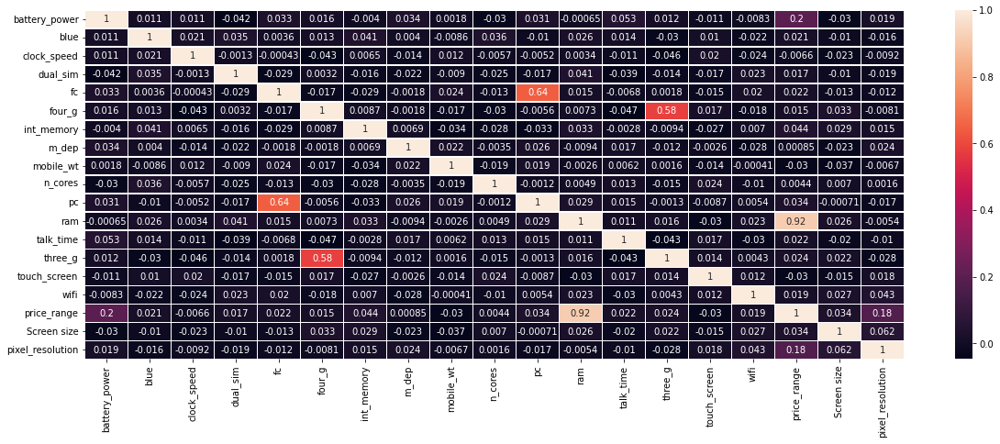

In [119]:
# Correlation Heatmap visualization code
f, ax = plt.subplots(figsize=(20, 7))
sns.heatmap(data.corr(), annot=True, linewidths=.5, ax=ax)

##### 1. Why did you pick the specific chart?

Heatmaps provide us with an easy tool to understand the correlation between two entities, they can be used to visualize the correlation among the features of a machine learning model. This may help in feature selection by eliminating highly correlated features.

##### 2. What is/are the insight(s) found from the chart?

1) Target Variable is highly or positively correlated with the ram of mobile phone which clearly means that if ram increases, price will increase and if ram decreases, price will also get decrease.So  RAM will play major deciding factor in estimating the price range.
2) 3G is positively correlated to the 4G network.
3) Front camera is positively correlated to the rear camera.So There is some collinearity in feature pairs ('pc', 'fc') but Front Camera megapixels and Primary camera megapixels are different entities despite of showing colinearity. So we'll be keeping them as they are.

#### Chart - 17 - Pair Plot 

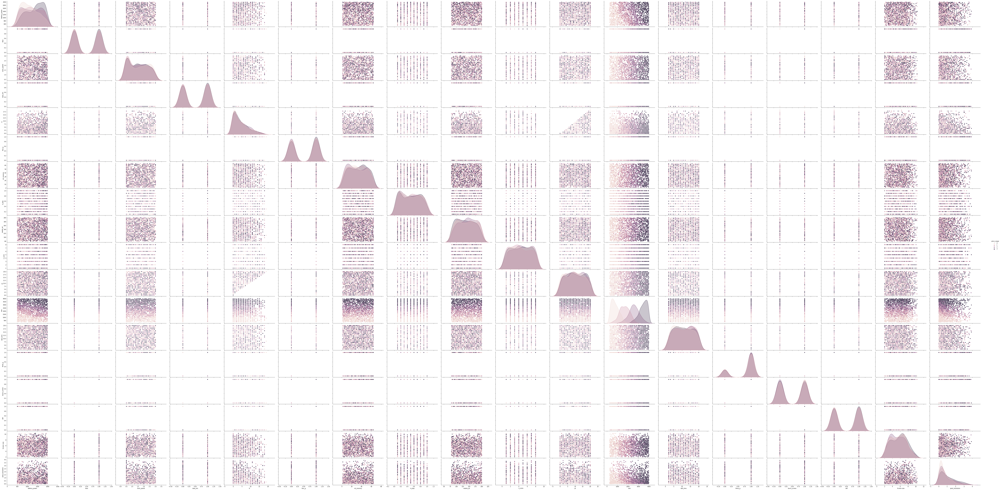

In [120]:
# Pair Plot visualization code
plt.rcParams['figure.figsize']=(10,10)
sns.pairplot(data=data,hue='price_range',kind='scatter',height=3,aspect=2)

##### 1. Why did you pick the specific chart?

A pairs plot allows us to see both distribution of single variables and relationships between two variables . Pair plots are a great method to identify trends for follow-up analysis and, fortunately, are easily implemented

## ***5. Feature Engineering & Data Pre-processing***

### 2. Handling Outliers

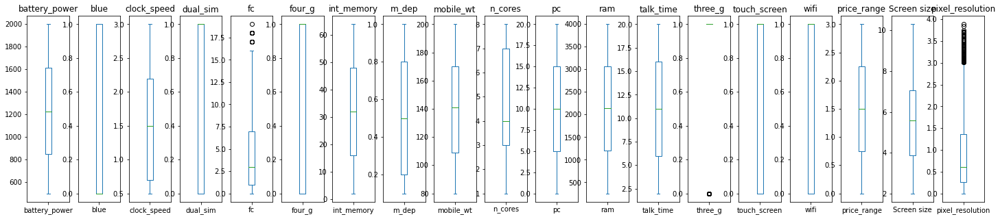

In [121]:
# Handling Outliers & Outlier treatments
numerical_column=[col for col in data.columns]
plt.rcParams["figure.figsize"] = (25,5)
fig, ax = plt.subplots(1, len(numerical_column))
for i, numerical_feature in enumerate(data[numerical_column]):
    data[numerical_feature].plot(kind="box", ax=ax[i]).set_title(numerical_feature)
fig.show()


##### What all outlier treatment techniques have you used and why did you use those techniques?

#Since there are not much outliers present in our dataset, so we don't need to handle outliers.

### 4. Feature Manipulation & Selection

#### 1. Feature Manipulation

In [122]:
# Manipulate Features to minimize feature correlation and create new features
from statsmodels.stats.outliers_influence import variance_inflation_factor
def calc_vif(X):
    '''Function which will calculate vif for all variables'''
    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    return(vif)

In [123]:
#Checking multicollinearty
multicolinearty=calc_vif(data[[i for i in data.describe().columns if i not in ['price_range']]])
multicolinearty

,variables,VIF
0,battery_power,7.998071
1,blue,1.980094
2,clock_speed,4.238985
3,dual_sim,2.001803
4,fc,3.412125
5,four_g,3.193227
6,int_memory,3.934872
7,m_dep,3.886276
8,mobile_wt,12.508629
9,n_cores,4.587926


In [124]:
multicolinearty=calc_vif(data[[i for i in data.describe().columns if i not in ['price_range','mobile_wt']]])
multicolinearty

,variables,VIF
0,battery_power,7.651838
1,blue,1.975098
2,clock_speed,4.128511
3,dual_sim,1.985964
4,fc,3.411225
5,four_g,3.192163
6,int_memory,3.896196
7,m_dep,3.803586
8,n_cores,4.500642
9,pc,6.146151


#### 2. Feature Selection

In [125]:
# Select features to avoid overfitting
x=data.drop(['price_range'],axis=1)
y=data['price_range']

In [126]:
x.columns

Index(['battery_power', 'blue', 'clock_speed', 'dual_sim', 'fc', 'four_g',
       'int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'ram', 'talk_time',
       'three_g', 'touch_screen', 'wifi', 'Screen size', 'pixel_resolution'],
      dtype='object')

##### What all feature selection methods have you used  and why?

I have used heatmap to know the correlation among the independent variables and variable inflation factor method to know the vif value for each variable, if vif value for any variable is above 10 then we need to apply something to the variables so that vif value gets below 10.

VIF is applied because it is very easy and convenient to get the correlation between the variables.

### 6. Data Scaling

In [127]:
# Scaling your data
scaler = MinMaxScaler()
x_scaled = scaler.fit_transform(x)


##### Which method have you used to scale you data and why?

Min Max Scaler is used to scale the data because i want to have a light touch. It's non-distorting method.

### 8. Data Splitting

In [128]:
# Split data to train and test. Choosing Splitting ratio.
x_train, x_test, y_train, y_test = train_test_split(x_scaled, y, test_size = 0.20, random_state = 42,stratify=y)


##### What data splitting ratio have you used and why? 

80:20 is used in modelling because we have only 2000 rows that is dataset is not much large so more data is required to train the model and we can't even compromise the testing data also.

## ***6. ML Model Implementation***

In [129]:
# Defining function for fing the auc-roc score for multiclass variable
def roc_auc_score_multiclass(actual_class, pred_class, average = "macro"):
   #creating a set of all the unique classes using the actual class list
    unique_class = set(actual_class)
    roc_auc_dict = {}
    for per_class in unique_class:
        
        #creating a list of all the classes except the current class 
        other_class = [x for x in unique_class if x != per_class]
         #marking the current class as 1 and all other classes as 0
        new_actual_class = [0 if x in other_class else 1 for x in actual_class]
        new_pred_class = [0 if x in other_class else 1 for x in pred_class]

        #using the sklearn metrics method to calculate the roc_auc_score
        roc_auc = roc_auc_score(new_actual_class, new_pred_class, average = average)
        roc_auc_dict[per_class] = roc_auc

    return roc_auc_dict

In [130]:
#Defining function to get evaluation metrices for all applied models
train_AccuracyScore=[]
train_PrecisionScore=[]
train_RecallScore=[]
train_F1Score=[]
test_AccuracyScore=[]
test_PrecisionScore=[]
test_RecallScore=[]
test_F1Score=[]


def model_metrics(model,x_train,y_train,x_test,y_test):
    '''This function will give us the model accuracy,confusion metrix,precision score,recall score,f1 score and auc-roc score and will also give
    the visualisation of predicted and actual data values for each model '''
    # Fit Model
    model.fit(x_train,y_train)
    
    # Get Metrices
    predict_train = model.predict(x_train)
    predict_test = model.predict(x_test)
    
    print('\n================Evalution Matrix for training data=============\n')
    train_accuracy=accuracy_score(predict_train,y_train)
    print('Accuracy score : ',train_accuracy)
    train_cmatrix=confusion_matrix(predict_train,y_train)
    print('Confusion matrix : \n',train_cmatrix)
    plt.rcParams["figure.figsize"] = (6,3)
    ax = sns.heatmap(train_cmatrix, annot=True, cmap='Blues')
    ax.set_title('Seaborn Confusion Matrix for training data');
    ax.set_xlabel('\nPredicted Values')
    ax.set_ylabel('Actual Values ');
    plt.show()
    train_pscore=precision_score(predict_train,y_train,average='micro')
    print('Precision score : ',train_pscore)
    train_rscore=recall_score(predict_train,y_train,average='micro')
    print('Recall score : ',train_rscore)
    train_fscore=f1_score(predict_train,y_train,average='micro')
    print('F1 score : ',train_fscore)
    aucScore=roc_auc_score_multiclass(predict_train,y_train)
    print("Roc Auc score : ",aucScore)
    print('\n================Evalution Matrix for testing data=============\n')
    test_accuracy=accuracy_score(predict_test,y_test)
    print('Accuracy score : ',test_accuracy)
    test_cmatrix=confusion_matrix(predict_test,y_test)
    print('Confusion matrix : \n',test_cmatrix)
    plt.rcParams["figure.figsize"] = (6,3)
    ax = sns.heatmap(test_cmatrix, annot=True, cmap='Blues')
    ax.set_title('Seaborn Confusion Matrix for testing data');
    ax.set_xlabel('\nPredicted Values')
    ax.set_ylabel('Actual Values ');
    plt.show()
    test_pscore=precision_score(predict_test,y_test,average='micro')
    print('Precision score : ',test_pscore)
    test_rscore=recall_score(predict_test,y_test,average='micro')
    print('Recall score : ',test_rscore)
    test_fscore=f1_score(predict_test,y_test,average='micro')
    print('F1 score : ',test_fscore)
    aucScore=roc_auc_score_multiclass(predict_test,y_test)
    print("Roc Auc score : ",aucScore)
    train_AccuracyScore.append(train_accuracy)
    train_PrecisionScore.append(train_pscore)
    train_RecallScore.append(train_rscore)
    train_F1Score.append(train_fscore)
    test_AccuracyScore.append(test_accuracy)
    test_PrecisionScore.append(test_pscore)
    test_RecallScore.append(test_rscore)
    test_F1Score.append(test_fscore)
    print('\
    =========================================================\
    Evalution Graph\
    ===================================================\n') 
    plt.figure(figsize=(15,6))
    plt.plot(np.array(y_test[:100]))
    plt.plot(predict_test[:100])    
    plt.legend(["ACTUAL","PREDICTED"],prop={'size': 20})
    plt.show()



    

In [131]:
def model_feature_importance(model,x):
  ''' this functions shows the important features in decreasing order'''
  feature_importance = pd.DataFrame({'Feature':x.columns,
                                   'Score':model.feature_importances_}).sort_values(by='Score', ascending=False).reset_index(drop=True)
  print('important features')                               
  print(feature_importance.head())
  fig, ax = plt.subplots(figsize=(12,3))
  ax = sns.barplot(x=feature_importance['Score'], y=feature_importance['Feature'])
  plt.title('Graph of feature importance')
  plt.show()

### ML Model - 1

In [132]:
# ML Model - 1 Implementation------- Logistic Regression
logmodel=LogisticRegression()
logmodel.fit(x_train,y_train) #model training



LogisticRegression()


================Evalution Matrix for training data=============

Accuracy score :  0.90625
Confusion matrix : 
 [[387  29   0   0]
 [ 13 344  33   0]
 [  0  27 335  16]
 [  0   0  32 384]]


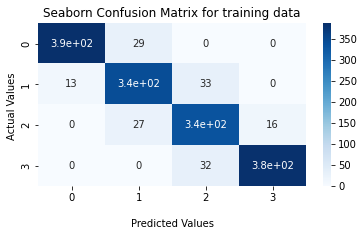

Precision score :  0.90625
Recall score :  0.90625
F1 score :  0.90625
Roc Auc score :  {0: 0.9596543659043659, 1: 0.9178851451578725, 2: 0.9165259484408421, 3: 0.9547817047817049}

================Evalution Matrix for testing data=============

Accuracy score :  0.89
Confusion matrix : 
 [[97  6  0  0]
 [ 3 84 11  0]
 [ 0 10 79  4]
 [ 0  0 10 96]]


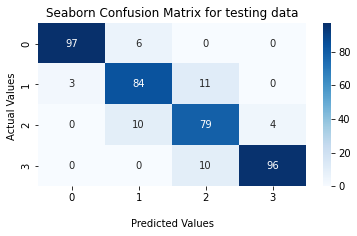

Precision score :  0.89
Recall score :  0.89
F1 score :  0.89
Roc Auc score :  {0: 0.965823281357262, 1: 0.902081362346263, 2: 0.8905292283983048, 3: 0.9460274675908099}
    =========================================================    Evalution Graph    ===================================================



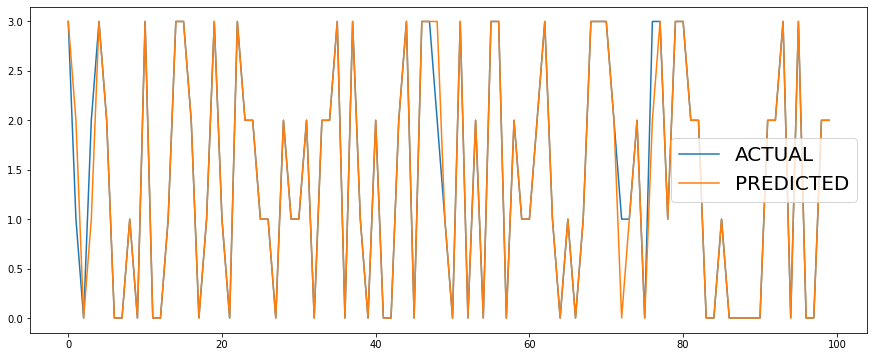

In [133]:
#Calling the function to get all scores in one go
model_metrics(logmodel,x_train,y_train,x_test,y_test)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

Logistic regression is a statistical method that is used for building machine learning models where the dependent variable is dichotomous: i.e. binary. Logistic regression is used to describe data and the relationship between one dependent variable and one or more independent variables. The independent variables can be nominal, ordinal, or of interval type.

The name “logistic regression” is derived from the concept of the logistic function that it uses. The logistic function is also known as the sigmoid function. The value of this logistic function lies between zero and one.

#Performance Analysis
The model shows the pretty good result both for testing and training data.All scores-accuracy score,precision score and f1 score are all same for this model. So considering best evaluation to be accuracy score for this dataset, our model accuracy score for the training data is 90.625% and for the testing data, it is 89%

#### 2. Cross- Validation & Hyperparameter Tuning

/usr/local/lib/python3.8/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
70 fits failed out of a total of 140.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
70 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_logistic.py", line 1461, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_logistic.py", line 447, in _check_solver
    raise ValueError(
ValueError: Solver 


================Evalution Matrix for training data=============

Accuracy score :  0.95625
Confusion matrix : 
 [[395  11   0   0]
 [  5 376  14   0]
 [  0  13 373  14]
 [  0   0  13 386]]


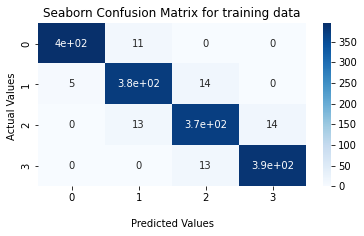

Precision score :  0.95625
Recall score :  0.95625
F1 score :  0.95625
Roc Auc score :  {0: 0.9843593996253847, 1: 0.9659908608645411, 2: 0.9550000000000001, 3: 0.9778807969131822}

================Evalution Matrix for testing data=============

Accuracy score :  0.94
Confusion matrix : 
 [[97  3  0  0]
 [ 3 91  3  0]
 [ 0  6 92  4]
 [ 0  0  5 96]]


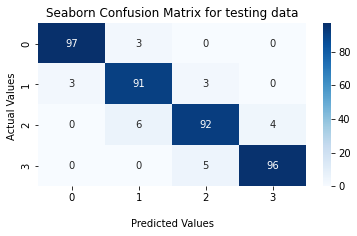

Precision score :  0.94
Recall score :  0.94
F1 score :  0.94
Roc Auc score :  {0: 0.98, 1: 0.9542206797999387, 2: 0.9375575733649165, 3: 0.9685585615417729}
    =========================================================    Evalution Graph    ===================================================



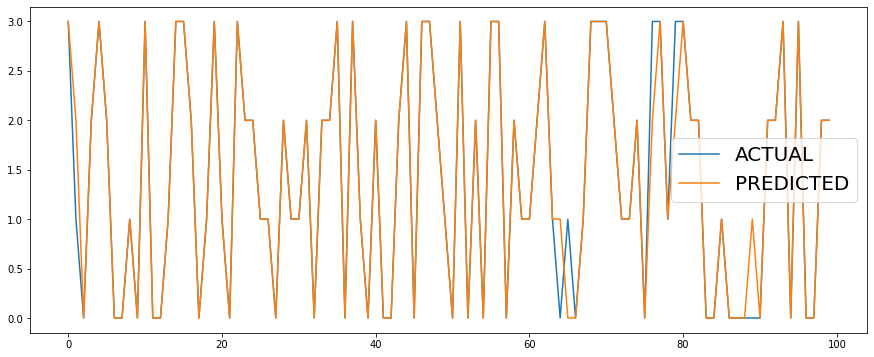

In [134]:
# ML Model - 1 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)
grid={"C":np.logspace(-3,3,7), "penalty":["l1","l2"]} # l1 lasso l2 ridge
logmodel_cv=GridSearchCV(logmodel,grid,cv=10)
# Fit the Algorithm
logmodel_cv.fit(x_train,y_train)
# Predict on the model
model_metrics(logmodel_cv,x_train,y_train,x_test,y_test)


##### Which hyperparameter optimization technique have you used and why?

I have used Grid Search CV because GridSearchCV is a technique to search through the best parameter values from the given set of the grid of parameters. It is basically a cross-validation method. the model and the parameters are required to be fed in. Best parameter values are extracted and then the predictions are made.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

After applying the Grid Search,logistic regression shows us the improved results. Now the model training accuracy is 95.625% and the model testing accuracy is 94%.

#ML Model 2

In [135]:
# ML Model - 1 Implementation------- Decision Tree Classifier
dtree=DecisionTreeClassifier(max_depth=5)
#Training the model
dtree.fit(x_train,y_train)

DecisionTreeClassifier(max_depth=5)


================Evalution Matrix for training data=============

Accuracy score :  0.885625
Confusion matrix : 
 [[361  10   0   0]
 [ 39 369  48   0]
 [  0  21 307  20]
 [  0   0  45 380]]


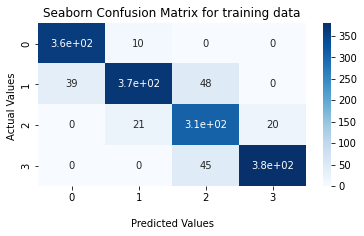

Precision score :  0.885625
Recall score :  0.885625
F1 score :  0.8856249999999999
Roc Auc score :  {0: 0.9706563528738329, 1: 0.8910563121089436, 2: 0.9039513789431163, 3: 0.9385481852315394}

================Evalution Matrix for testing data=============

Accuracy score :  0.855
Confusion matrix : 
 [[92  3  0  0]
 [ 8 84 14  0]
 [ 0 13 73  7]
 [ 0  0 13 93]]


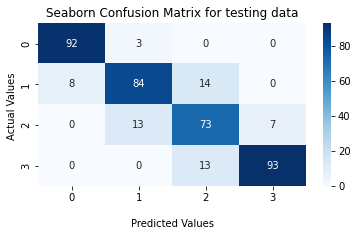

Precision score :  0.855
Recall score :  0.855
F1 score :  0.855
Roc Auc score :  {0: 0.9710957722174288, 1: 0.8690155307405982, 2: 0.8484991769114916, 3: 0.9267744833782569}
    =========================================================    Evalution Graph    ===================================================



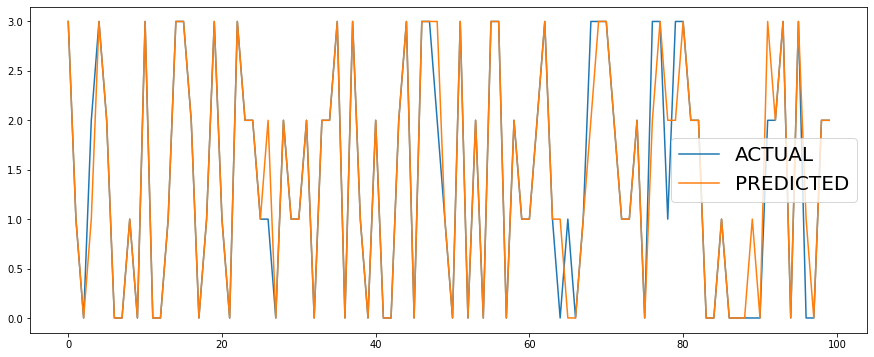

In [136]:
#Calling the function to get model scores
model_metrics(dtree,x_train,y_train,x_test,y_test)

important features
            Feature     Score
0               ram  0.740115
1  pixel_resolution  0.132532
2     battery_power  0.120348
3         mobile_wt  0.005427
4       clock_speed  0.000899


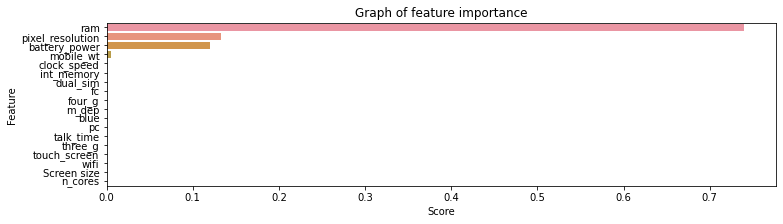

In [137]:
model_feature_importance(dtree,x)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

Decision trees are constructed via an algorithmic approach that identifies ways to split a data set based on different conditions. It is one of the most widely used and practical methods for supervised learning. Decision Trees are a non-parametric supervised learning method used for both classification and regression tasks.

#Performance Analysis
The model shows the  good result both for testing and training data.All scores-accuracy score,precision score and f1 score are all same for this model. So considering best evaluation to be accuracy score for this dataset, our model accuracy score for the training data is 88.56% and for the testing data, it is 85.5%

#### 2. Cross- Validation & Hyperparameter Tuning

Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5; 1/9] START max_depth=1.................................................
[CV 1/5; 1/9] END ..................max_depth=1;, score=0.500 total time=   0.0s
[CV 2/5; 1/9] START max_depth=1.................................................
[CV 2/5; 1/9] END ..................max_depth=1;, score=0.497 total time=   0.0s
[CV 3/5; 1/9] START max_depth=1.................................................
[CV 3/5; 1/9] END ..................max_depth=1;, score=0.497 total time=   0.0s
[CV 4/5; 1/9] START max_depth=1.................................................
[CV 4/5; 1/9] END ..................max_depth=1;, score=0.500 total time=   0.0s
[CV 5/5; 1/9] START max_depth=1.................................................
[CV 5/5; 1/9] END ..................max_depth=1;, score=0.500 total time=   0.0s
[CV 1/5; 2/9] START max_depth=4.................................................
[CV 1/5; 2/9] END ..................max_depth=4;,

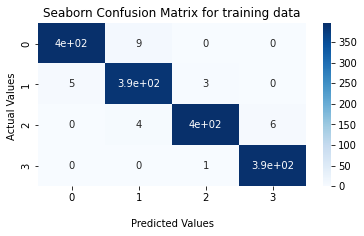

Precision score :  0.9825
Recall score :  0.9825
F1 score :  0.9825
Roc Auc score :  {0: 0.9867710851352693, 1: 0.9844792268501497, 2: 0.9860096871879925, 3: 0.9962445506591733}

================Evalution Matrix for testing data=============

Accuracy score :  0.865
Confusion matrix : 
 [[96  4  0  0]
 [ 4 79 13  0]
 [ 0 17 81 10]
 [ 0  0  6 90]]


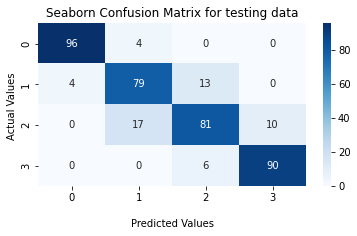

Precision score :  0.865
Recall score :  0.865
F1 score :  0.865
Roc Auc score :  {0: 0.9733333333333333, 1: 0.8769188596491229, 2: 0.8424657534246575, 3: 0.9523026315789473}
    =========================================================    Evalution Graph    ===================================================



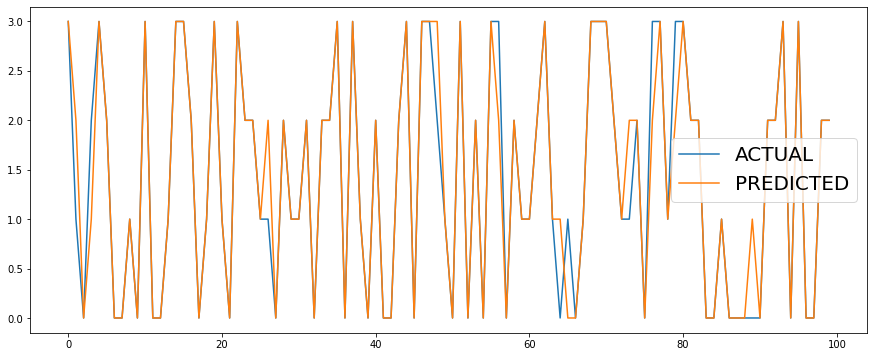

In [138]:
# ML Model - 1 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)
param={'max_depth': [1,4,5,7,8,10,12,15,20]}
grid = GridSearchCV(dtree, param, scoring = 'accuracy', cv = 5, verbose = 24)
grid.fit(x_train,y_train)
model_metrics(grid,x_train,y_train,x_test,y_test)

##### Which hyperparameter optimization technique have you used and why?

I have used Grid Search CV because GridSearchCV is a technique to search through the best parameter values from the given set of the grid of parameters. It is basically a cross-validation method. the model and the parameters are required to be fed in. Best parameter values are extracted and then the predictions are made.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

After applying the Grid Search,decision tree classifiers shows us the model training accuracy as 99.43% and the model testing accuracy as 86.5%.It seems that model gets overfitted as there is large difference between the training and testing accuracy.

### ML Model - 3

#Random Forest Classifier


================Evalution Matrix for training data=============

Accuracy score :  1.0
Confusion matrix : 
 [[400   0   0   0]
 [  0 400   0   0]
 [  0   0 400   0]
 [  0   0   0 400]]


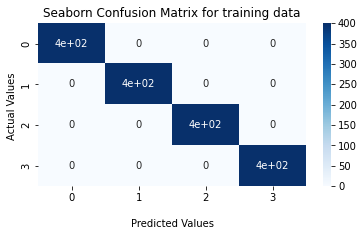

Precision score :  1.0
Recall score :  1.0
F1 score :  1.0
Roc Auc score :  {0: 1.0, 1: 1.0, 2: 1.0, 3: 1.0}

================Evalution Matrix for testing data=============

Accuracy score :  0.8875
Confusion matrix : 
 [[95  5  0  0]
 [ 5 84 11  0]
 [ 0 11 83  7]
 [ 0  0  6 93]]


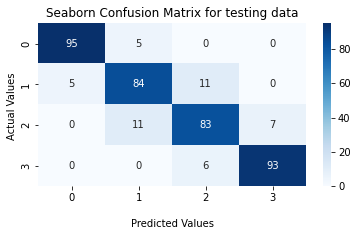

Precision score :  0.8875
Recall score :  0.8875
F1 score :  0.8875
Roc Auc score :  {0: 0.9666666666666666, 1: 0.8933333333333332, 2: 0.8824629954634259, 3: 0.9580690627202255}
    =========================================================    Evalution Graph    ===================================================



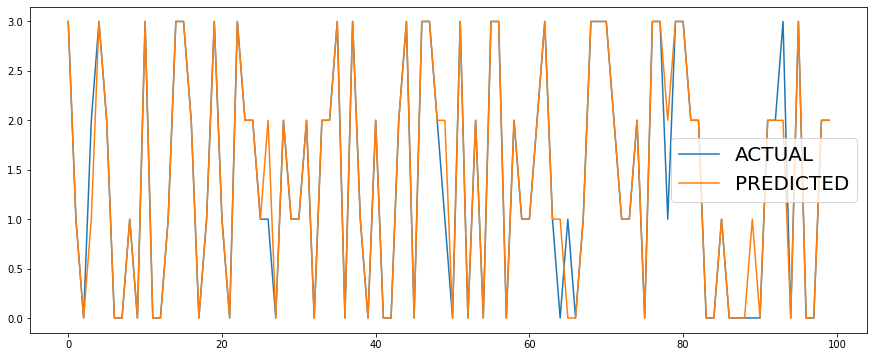

important features
            Feature     Score
0               ram  0.511232
1     battery_power  0.080679
2  pixel_resolution  0.075580
3       Screen size  0.041587
4         mobile_wt  0.041170


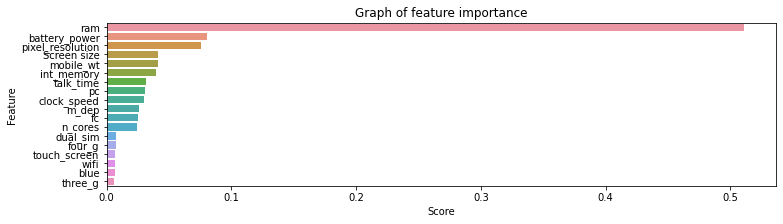

In [139]:
#Applying random forest classifier
# taking 300 trees
forest_classifier = RandomForestClassifier(n_estimators=300)
forest_classifier.fit(x_train, y_train)
#calling functions to get all scores for the model
model_metrics(forest_classifier,x_train,y_train,x_test,y_test)
#Lets look into the important features
model_feature_importance(forest_classifier,x)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

A random forest is a meta estimator that fits a number of decision tree classifiers on various sub-samples of the dataset and uses averaging to improve the predictive accuracy and control over-fitting. The sub-sample size is controlled with the max_samples parameter if bootstrap=True (default), otherwise the whole dataset is used to build each tree.

#Performance Analysis
Random forest classifier performs good in training data having training accuracy score to be 100% but when applied to testing data, it gives only 88.25% as testing accuracy score. 


#### 2. Cross- Validation & Hyperparameter Tuning


================Evalution Matrix for training data=============

Accuracy score :  0.9475
Confusion matrix : 
 [[388  18   0   0]
 [ 12 362  19   0]
 [  0  20 369   3]
 [  0   0  12 397]]


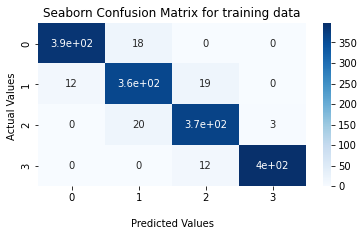

Precision score :  0.9475
Recall score :  0.9475
F1 score :  0.9475
Roc Auc score :  {0: 0.9728073866871302, 1: 0.9448182885669052, 2: 0.9578321394783079, 3: 0.9840706275058047}

================Evalution Matrix for testing data=============

Accuracy score :  0.865
Confusion matrix : 
 [[97  7  0  0]
 [ 3 82 18  0]
 [ 0 11 73  6]
 [ 0  0  9 94]]


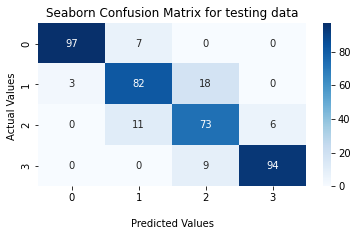

Precision score :  0.865
Recall score :  0.865
F1 score :  0.865
Roc Auc score :  {0: 0.9612785862785864, 1: 0.8677552221241543, 2: 0.8620071684587812, 3: 0.9462096695106403}
    =========================================================    Evalution Graph    ===================================================



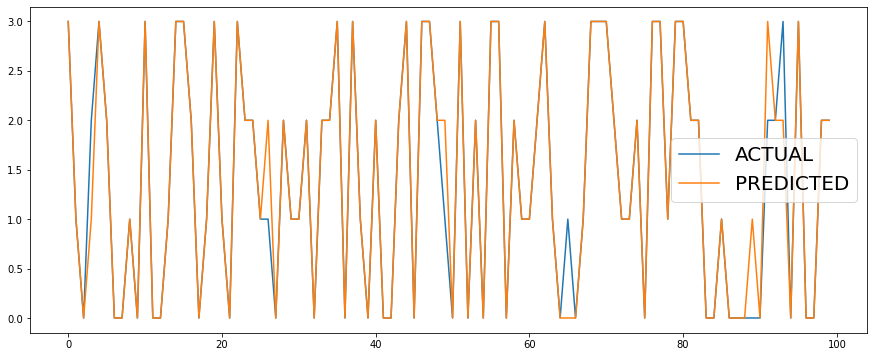

In [140]:
# ML Model - 1 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)
params = {'n_estimators':[10,50,100,200],
          'max_depth':[10,20,30,40],
           'min_samples_split':[2,4,6],
          'max_features':['sqrt',4,'log2','auto'],
          'max_leaf_nodes':[10, 20, 40]
          }
random_cv=GridSearchCV(forest_classifier,params, scoring='accuracy', cv=3)
# Fit the Algorithm
random_cv.fit(x_train,y_train)
# Predict on the model
model_metrics(random_cv,x_train,y_train,x_test,y_test)

##### Which hyperparameter optimization technique have you used and why?

I have used Grid Search CV because GridSearchCV is a technique to search through the best parameter values from the given set of the grid of parameters. It is basically a cross-validation method. the model and the parameters are required to be fed in. Best parameter values are extracted and then the predictions are made.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

Not seen much improvements after applying hyperparameters to the random forest classifier, Training accuracy downs to 94.06% and testing accuracy downs to 86%.previously it is 100% and 88.25% before applying hyperparameters.

### ML Model - 4

#XGB Classifier


================Evalution Matrix for training data=============

Accuracy score :  0.999375
Confusion matrix : 
 [[400   0   0   0]
 [  0 400   1   0]
 [  0   0 399   0]
 [  0   0   0 400]]


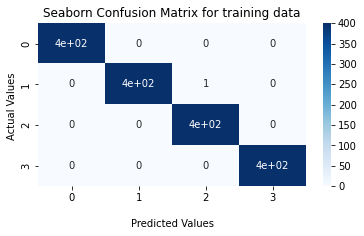

Precision score :  0.999375
Recall score :  0.999375
F1 score :  0.999375
Roc Auc score :  {0: 1.0, 1: 0.9987531172069826, 2: 0.9995836802664446, 3: 1.0}

================Evalution Matrix for testing data=============

Accuracy score :  0.9225
Confusion matrix : 
 [[96  3  0  0]
 [ 4 92  7  0]
 [ 0  5 87  6]
 [ 0  0  6 94]]


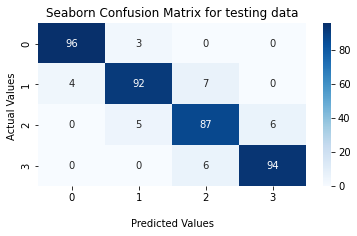

Precision score :  0.9225
Recall score :  0.9225
F1 score :  0.9225
Roc Auc score :  {0: 0.9782039665760596, 1: 0.9331339282795594, 2: 0.9223543722124611, 3: 0.96}
    =========================================================    Evalution Graph    ===================================================



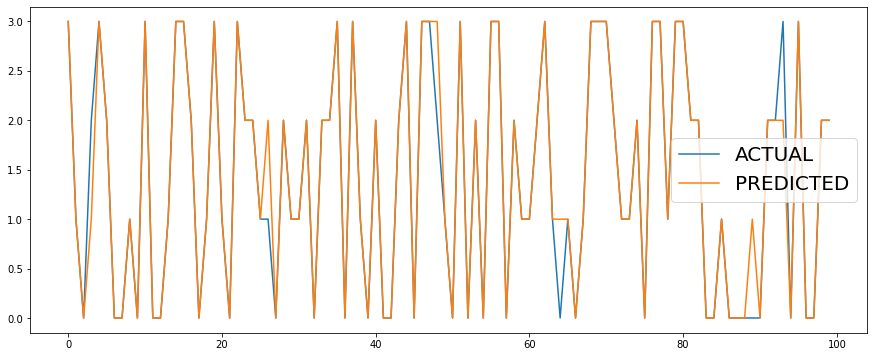

In [141]:
# ML Model - 4 Implementation-----XGB Classifier
xgb = XGBClassifier(max_depth = 5, learning_rate = 0.1)


# Fit the Algorithm
xgb.fit(x_train, y_train)
# Predict on the model
model_metrics(xgb,x_train,y_train,x_test,y_test)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

XGBoost, which stands for Extreme Gradient Boosting, is a scalable, distributed gradient-boosted decision tree (GBDT) machine learning library. It provides parallel tree boosting and is the leading machine learning library for regression, classification, and ranking problems.

#Performance Analysis
XGB Classifier gives good results for both testing and training data,since all scores are same so we can consider any score to prove its performance as training accuracy for this model is 99.94% and testing accuracy score is 92.25%.

#### 2. Cross- Validation & Hyperparameter Tuning

Fitting 5 folds for each of 20 candidates, totalling 100 fits
[CV 1/5; 1/20] START learning_rate=1, max_depth=5, n_estimators=10..............
[CV 1/5; 1/20] END learning_rate=1, max_depth=5, n_estimators=10;, score=0.891 total time=   0.2s
[CV 2/5; 1/20] START learning_rate=1, max_depth=5, n_estimators=10..............
[CV 2/5; 1/20] END learning_rate=1, max_depth=5, n_estimators=10;, score=0.872 total time=   0.1s
[CV 3/5; 1/20] START learning_rate=1, max_depth=5, n_estimators=10..............
[CV 3/5; 1/20] END learning_rate=1, max_depth=5, n_estimators=10;, score=0.859 total time=   0.1s
[CV 4/5; 1/20] START learning_rate=1, max_depth=5, n_estimators=10..............
[CV 4/5; 1/20] END learning_rate=1, max_depth=5, n_estimators=10;, score=0.884 total time=   0.1s
[CV 5/5; 1/20] START learning_rate=1, max_depth=5, n_estimators=10..............
[CV 5/5; 1/20] END learning_rate=1, max_depth=5, n_estimators=10;, score=0.884 total time=   0.1s
[CV 1/5; 2/20] START learning_rate=1, max_d

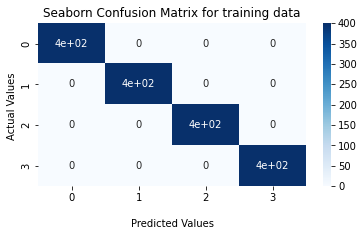

Precision score :  1.0
Recall score :  1.0
F1 score :  1.0
Roc Auc score :  {0: 1.0, 1: 1.0, 2: 1.0, 3: 1.0}

================Evalution Matrix for testing data=============

Accuracy score :  0.915
Confusion matrix : 
 [[97  4  0  0]
 [ 3 90  8  0]
 [ 0  6 86  7]
 [ 0  0  6 93]]


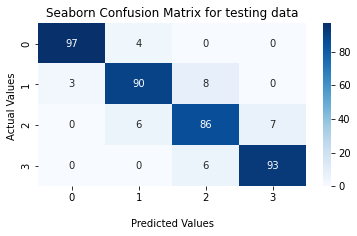

Precision score :  0.915
Recall score :  0.915
F1 score :  0.915
Roc Auc score :  {0: 0.9751812973939534, 1: 0.9288221464286897, 2: 0.9110876203899461, 3: 0.9580690627202255}
    =========================================================    Evalution Graph    ===================================================



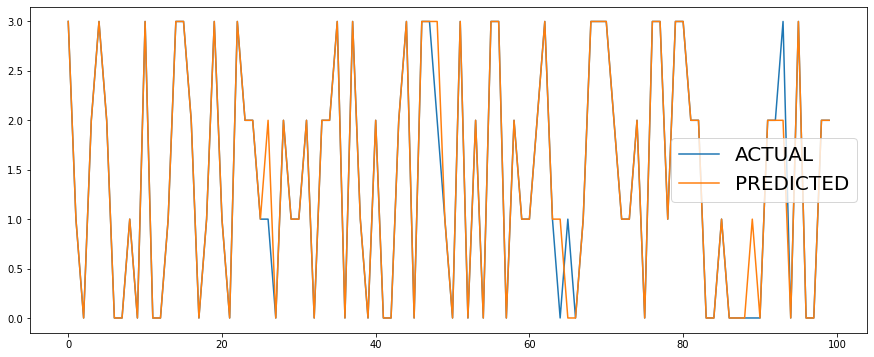

In [142]:
# ML Model - 3 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)
grid_xgb = GridSearchCV(xgb, param_grid={'n_estimators': (10,20), 'learning_rate': [1, 0.5, 0.1, 0.01, 0.001], 'max_depth': (5,6)},cv = 5, scoring = 'accuracy', verbose = 10)
                                  


# Fit the Algorithm
grid_xgb.fit(x_train,y_train)
# Predict on the model
model_metrics(grid_xgb,x_train,y_train,x_test,y_test)

In [143]:
grid_xgb.best_estimator_

XGBClassifier(learning_rate=0.5, max_depth=6, n_estimators=20,
              objective='multi:softprob')

##### Which hyperparameter optimization technique have you used and why?

I have used Grid Search CV because GridSearchCV is a technique to search through the best parameter values from the given set of the grid of parameters. It is basically a cross-validation method. the model and the parameters are required to be fed in. Best parameter values are extracted and then the predictions are made.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

No improvement seen, The model seems to be overfitted with training data. Now the training accuracy score is 100% and testing accuracy score is 91.5%.






#ML Model-5

#KNeighbors Classifier

In [144]:
# applying KNeighborsClassifier
#Setup arrays to store training and test accuracies
neighbors = np.arange(50,60)
train_accuracy =np.empty(len(neighbors))
test_accuracy = np.empty(len(neighbors))

for i,k in enumerate(neighbors):
    # Setup a knn classifier with k neighbors
    knn = KNeighborsClassifier(n_neighbors=k)
    
    # Fit the model
    knn.fit(x_train, y_train)
    
    # Compute accuracy on the training set
    train_accuracy[i] = knn.score(x_train, y_train)
    
    # Compute accuracy on the test set
    test_accuracy[i] = knn.score(x_test, y_test)

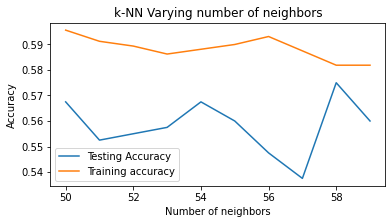

In [145]:
# Generate plot
plt.title('k-NN Varying number of neighbors')
plt.plot(neighbors, test_accuracy, label='Testing Accuracy')
plt.plot(neighbors, train_accuracy, label='Training accuracy')
plt.legend()
plt.xlabel('Number of neighbors')
plt.ylabel('Accuracy')
plt.show()


================Evalution Matrix for training data=============

Accuracy score :  0.581875
Confusion matrix : 
 [[300 125  24   1]
 [ 74 178 108  23]
 [ 26  89 194 117]
 [  0   8  74 259]]


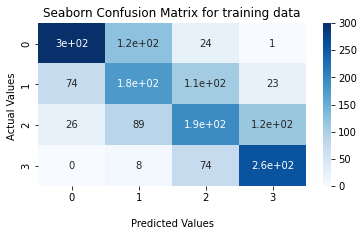

Precision score :  0.581875
Recall score :  0.581875
F1 score :  0.581875
Roc Auc score :  {0: 0.7898550724637681, 1: 0.641168090862477, 2: 0.6399652886084252, 3: 0.8237685730191303}

================Evalution Matrix for testing data=============

Accuracy score :  0.575
Confusion matrix : 
 [[71 33  5  0]
 [27 40 18  7]
 [ 2 22 57 31]
 [ 0  5 20 62]]


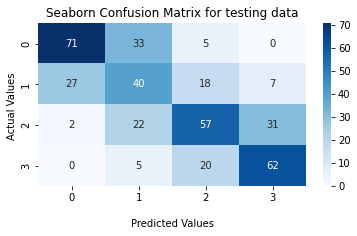

Precision score :  0.575
Recall score :  0.575
F1 score :  0.575
Roc Auc score :  {0: 0.7758598947003372, 1: 0.6199887069452287, 2: 0.6798115079365079, 3: 0.7956189636810987}
    =========================================================    Evalution Graph    ===================================================



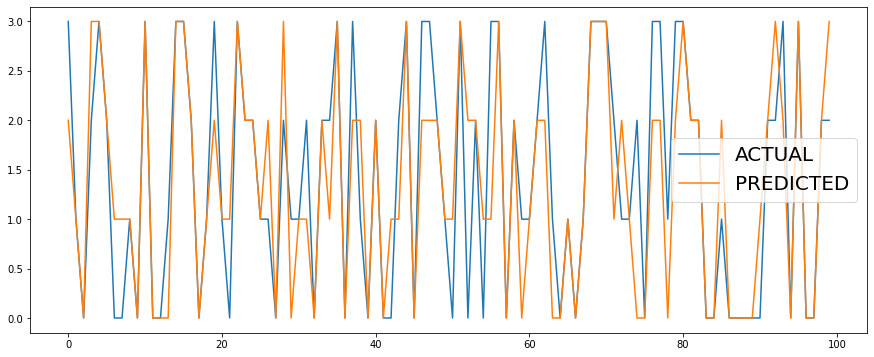

In [146]:
# instantiate the model with k=58
knn_58 = KNeighborsClassifier(n_neighbors=58)


# fit the model to the training set
knn_58.fit(x_train, y_train)

model_metrics(knn_58,x_train,y_train,x_test,y_test)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

The k-nearest neighbors algorithm, also known as KNN or k-NN, is a non-parametric, supervised learning classifier, which uses proximity to make classifications or predictions about the grouping of an individual data point.

For classification problems, a class label is assigned on the basis of a majority vote—i.e. the label that is most frequently represented around a given data point is used. While this is technically considered “plurality voting”, the term, “majority vote” is more commonly used in literature. The distinction between these terminologies is that “majority voting” technically requires a majority of greater than 50%, which primarily works when there are only two categories. When you have multiple classes—e.g. four categories, you don’t necessarily need 50% of the vote to make a conclusion about a class; you could assign a class label with a vote of greater than 25%.

#Performance Analysis
The model seems to be underfitted as training accuracy is 58.19% and the testing accuracy seems to be 57.5%.

#### 2. Cross- Validation & Hyperparameter Tuning


================Evalution Matrix for training data=============

Accuracy score :  0.596875
Confusion matrix : 
 [[313 133  29   0]
 [ 73 178 102  24]
 [ 14  78 206 118]
 [  0  11  63 258]]


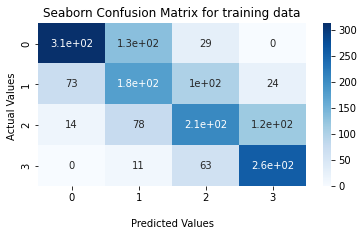

Precision score :  0.596875
Recall score :  0.596875
F1 score :  0.596875
Roc Auc score :  {0: 0.7908070175438596, 1: 0.6453138453730554, 2: 0.6656704781704782, 3: 0.8325605260157348}

================Evalution Matrix for testing data=============

Accuracy score :  0.53
Confusion matrix : 
 [[74 42  8  0]
 [23 35 24  5]
 [ 3 17 47 39]
 [ 0  6 21 56]]


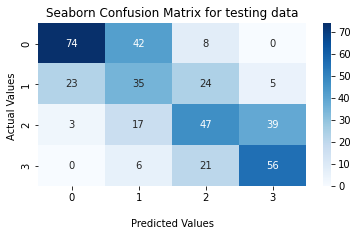

Precision score :  0.53
Recall score :  0.53
F1 score :  0.53
Roc Auc score :  {0: 0.7512856474988312, 1: 0.5973155594726599, 2: 0.6315620587857785, 3: 0.7679487666755349}
    =========================================================    Evalution Graph    ===================================================



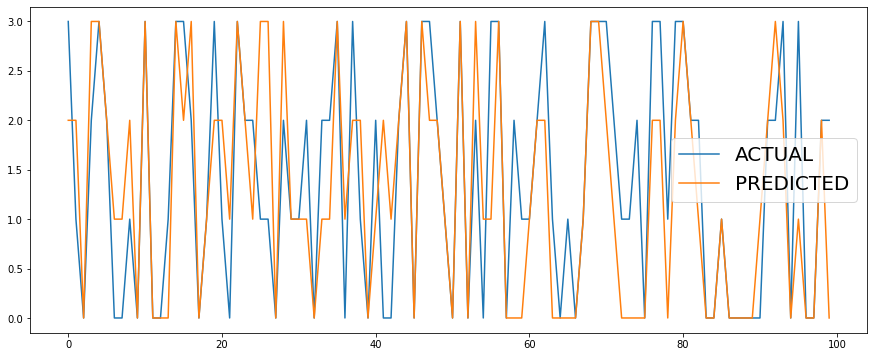

In [147]:
#Hyper tunning the model
k_range = list(range(30, 60))
param_grid = dict(n_neighbors=k_range)
grid_knn = GridSearchCV(knn, param_grid, cv=10, scoring='accuracy', return_train_score=False)
grid_knn.fit(x_train, y_train)
model_metrics(grid_knn,x_train,y_train,x_test,y_test)

##### Which hyperparameter optimization technique have you used and why?

I have used Grid Search CV because GridSearchCV is a technique to search through the best parameter values from the given set of the grid of parameters. It is basically a cross-validation method. the model and the parameters are required to be fed in. Best parameter values are extracted and then the predictions are made.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

No improvement seen, The model is still underfitted as the training accuracy score is 59.69% and testing accuracy score is 53%.






#ML Model-6

#Gaussian Naive Bias Classifier


================Evalution Matrix for training data=============

Accuracy score :  0.810625
Confusion matrix : 
 [[360  38   0   0]
 [ 40 297  65   1]
 [  0  65 286  45]
 [  0   0  49 354]]


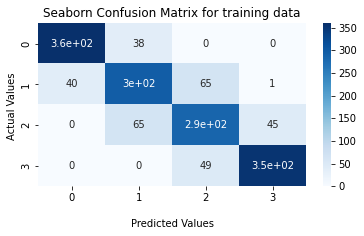

Precision score :  0.810625
Recall score :  0.810625
F1 score :  0.8106250000000002
Roc Auc score :  {0: 0.9356223714245102, 1: 0.8254621251225666, 2: 0.8137689184200813, 3: 0.919991251909758}

================Evalution Matrix for testing data=============

Accuracy score :  0.7975
Confusion matrix : 
 [[90  7  0  0]
 [10 69 18  0]
 [ 0 24 70 10]
 [ 0  0 12 90]]


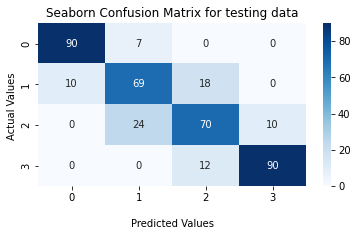

Precision score :  0.7975
Recall score :  0.7975
F1 score :  0.7975
Roc Auc score :  {0: 0.9474158756081794, 1: 0.8045149875812323, 2: 0.7858627858627859, 3: 0.9243979470983024}
    =========================================================    Evalution Graph    ===================================================



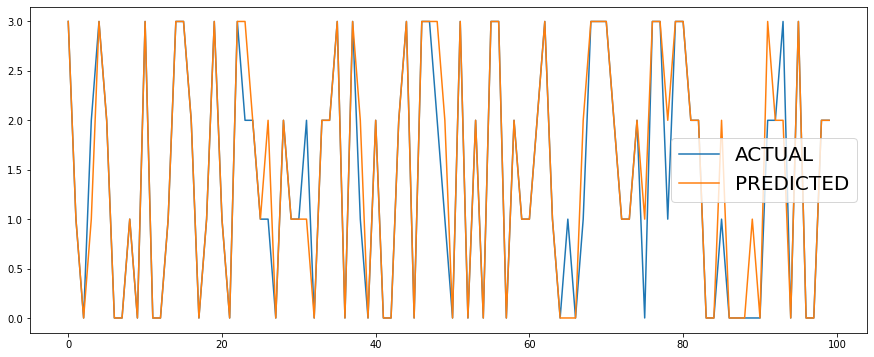

In [148]:
# train a Gaussian Naive Bayes classifier on the training set
# instantiate the model
gnb = GaussianNB()


# fit the model
gnb.fit(x_train, y_train)
#model scores
model_metrics(gnb,x_train,y_train,x_test,y_test)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

Gaussian Naive Bayes is a probabilistic classification algorithm based on applying Bayes' theorem with strong independence assumptions. In the context of classification, independence refers to the idea that the presence of one value of a feature does not influence the presence of another (unlike independence in probability theory). Naive refers to the use of an assumption that the features of an object are independent of one another. In the context of machine learning, naive Bayes classifiers are known to be highly expressive, scalable, and reasonably accurate, but their performance deteriorates rapidly with the growth of the training set. A number of features contribute to the success of naive Bayes classifiers. Most notably, they do not require any tuning of the parameters of the classification model, they scale well with the size of the training data set, and they can easily handle continuous features.



#Performance Analysis
Showing the good results with training accuracy to be 80.06% and testing accuracy to be 79.75%.

#### 2. Cross- Validation & Hyperparameter Tuning

In [149]:
#Hypertuning the model
cv_method = RepeatedStratifiedKFold(n_splits=5, 
                                    n_repeats=3, 
                                    random_state=999)

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 15 folds for each of 100 candidates, totalling 1500 fits

================Evalution Matrix for training data=============

Accuracy score :  0.820625
Confusion matrix : 
 [[373  45   0   0]
 [ 27 289  66   1]
 [  0  66 293  41]
 [  0   0  41 358]]


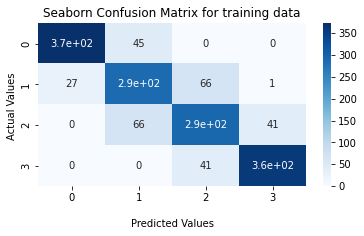

Precision score :  0.820625
Recall score :  0.820625
F1 score :  0.820625
Roc Auc score :  {0: 0.9347509290068734, 1: 0.8316806511753638, 2: 0.8216666666666667, 3: 0.9311361250753862}

================Evalution Matrix for testing data=============

Accuracy score :  0.805
Confusion matrix : 
 [[92  9  0  0]
 [ 8 68 19  0]
 [ 0 23 68  6]
 [ 0  0 13 94]]


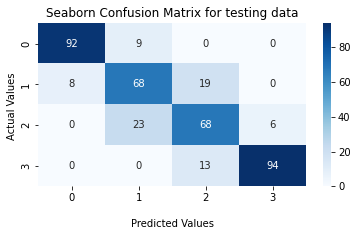

Precision score :  0.805
Recall score :  0.805
F1 score :  0.805
Roc Auc score :  {0: 0.9420676181330507, 1: 0.8054357204486626, 2: 0.797710183389473, 3: 0.9290134285987688}
    =========================================================    Evalution Graph    ===================================================



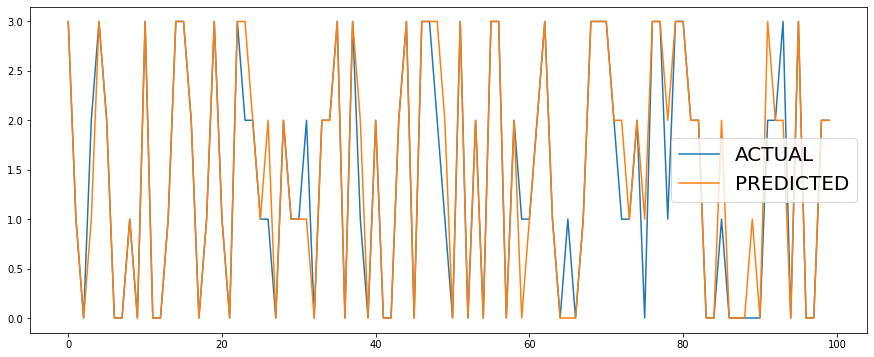

In [150]:
from sklearn.preprocessing import PowerTransformer
params_NB = {'var_smoothing': np.logspace(0,-9, num=100)}

gs_NB = GridSearchCV(estimator=gnb, 
                     param_grid=params_NB, 
                     cv=cv_method,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_test)

gs_NB.fit(Data_transformed, y_test)
model_metrics(gs_NB,x_train,y_train,x_test,y_test)

##### Which hyperparameter optimization technique have you used and why?

I have used Grid Search CV because GridSearchCV is a technique to search through the best parameter values from the given set of the grid of parameters. It is basically a cross-validation method. the model and the parameters are required to be fed in. Best parameter values are extracted and then the predictions are made.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

A little improvement seen, The model's training accuracy score is 82.06% and testing accuracy score is 80.5%.






#Model 7

#Support Vector Machine


================Evalution Matrix for training data=============

Accuracy score :  0.93125
Confusion matrix : 
 [[384  17   0   0]
 [ 16 364  20   0]
 [  0  19 359  17]
 [  0   0  21 383]]


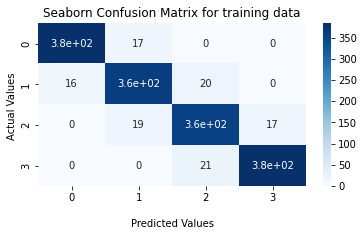

Precision score :  0.93125
Recall score :  0.93125
F1 score :  0.93125
Roc Auc score :  {0: 0.9721307656629901, 1: 0.9400000000000001, 2: 0.9374179316140554, 3: 0.9669028775787277}

================Evalution Matrix for testing data=============

Accuracy score :  0.9225
Confusion matrix : 
 [[98  2  0  0]
 [ 2 91  7  0]
 [ 0  7 86  6]
 [ 0  0  7 94]]


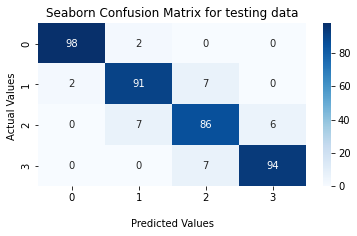

Precision score :  0.9225
Recall score :  0.9225
F1 score :  0.9225
Roc Auc score :  {0: 0.9866666666666666, 1: 0.9400000000000001, 2: 0.9110876203899461, 3: 0.9553130898374118}
    =========================================================    Evalution Graph    ===================================================



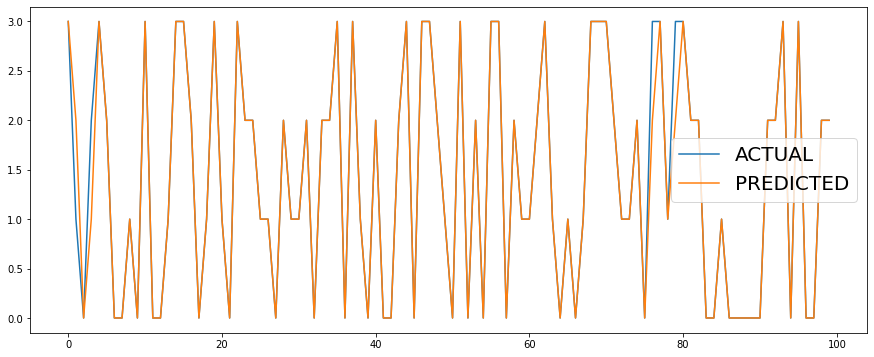

In [151]:
#Lets apply the Support vector classifier
svclassifier = SVC(kernel='linear', random_state=0)  
svclassifier.fit(x_train, y_train) 
model_metrics(svclassifier,x_train,y_train,x_test,y_test)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

Support Vector Machine or SVM is one of the most popular Supervised Learning algorithms, which is used for Classification as well as Regression problems. However, primarily, it is used for Classification problems in Machine Learning.

The goal of the SVM algorithm is to create the best line or decision boundary that can segregate n-dimensional space into classes so that we can easily put the new data point in the correct category in the future. This best decision boundary is called a hyperplane.

SVM chooses the extreme points/vectors that help in creating the hyperplane. These extreme cases are called as support vectors, and hence algorithm is termed as Support Vector Machine. Consider the below diagram in which there are two different categories that are classified using a decision boundary or hyperplane

#Performance Analysis
Showing the better results with training accuracy to be 93.13% and testing accuracy to be 92.3%. this model don't require any hyper tunning but still checking whether there will get any improvement.

#### 2. Cross- Validation & Hyperparameter Tuning

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END .....C=5.243643845530385, gamma=0.07564962352209965; total time=   0.1s
[CV] END .....C=5.243643845530385, gamma=0.07564962352209965; total time=   0.1s
[CV] END .....C=5.243643845530385, gamma=0.07564962352209965; total time=   0.1s
[CV] END ....C=6.968761071325121, gamma=0.005528765233463253; total time=   0.1s
[CV] END ....C=6.968761071325121, gamma=0.005528765233463253; total time=   0.1s
[CV] END ....C=6.968761071325121, gamma=0.005528765233463253; total time=   0.1s
[CV] END ...C=2.6851176245784116, gamma=0.010916339755952055; total time=   0.1s
[CV] END ...C=2.6851176245784116, gamma=0.010916339755952055; total time=   0.1s
[CV] END ...C=2.6851176245784116, gamma=0.010916339755952055; total time=   0.1s
[CV] END ....C=5.786808742960579, gamma=0.045067992172094964; total time=   0.1s
[CV] END ....C=5.786808742960579, gamma=0.045067992172094964; total time=   0.1s
[CV] END ....C=5.786808742960579, gamma=0.045067

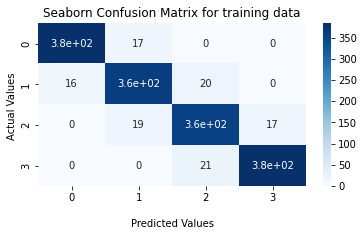

Precision score :  0.93125
Recall score :  0.93125
F1 score :  0.93125
Roc Auc score :  {0: 0.9721307656629901, 1: 0.9400000000000001, 2: 0.9374179316140554, 3: 0.9669028775787277}

================Evalution Matrix for testing data=============

Accuracy score :  0.9225
Confusion matrix : 
 [[98  2  0  0]
 [ 2 91  7  0]
 [ 0  7 86  6]
 [ 0  0  7 94]]


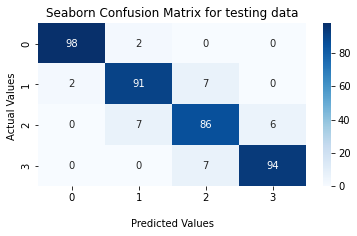

Precision score :  0.9225
Recall score :  0.9225
F1 score :  0.9225
Roc Auc score :  {0: 0.9866666666666666, 1: 0.9400000000000001, 2: 0.9110876203899461, 3: 0.9553130898374118}
    =========================================================    Evalution Graph    ===================================================



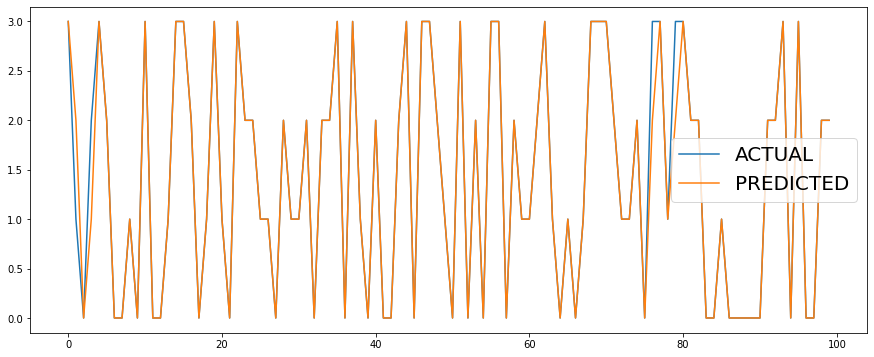

In [152]:
#Hypertune the parameter
param_distributions = {"gamma": reciprocal(0.001, 0.1), "C": uniform(1, 10)}
rnd_search_cv = RandomizedSearchCV(svclassifier, param_distributions, n_iter=10, verbose=2, cv=3)
rnd_search_cv.fit(x_train, y_train)
model_metrics(svclassifier,x_train,y_train,x_test,y_test)

##### Which hyperparameter optimization technique have you used and why?

Randomized search is used because it is good to find optimal combination of hyper parameters for creating the best model. Randomized search is a model tuning technique. Other techniques include grid search. Sklearn RandomizedSearchCV can be used to perform random search of hyper parameters

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

#Performance Analysis
Showing same results with training accuracy to be 93.13% and testing accuracy to be 92.3%. So, No improvement seen with hyper tunning.

#Final Model Outputs

In [153]:
model_name=['Logistic Regression','Grid Search Logistic Regression','Decision Tree','Grid Search Decision Tree','Random Forest Classifier','Grid Search Random Forest Classifier','XGB Classifier','Grid Search XGB Classifier','K-Neighbours Classifier','Grid Search K-Neighbours Classifier','Gaussian Naves bias','Grid Search Gaussian Naves bias','Support Vector Machine','Randomized Search SVM']
final_result=pd.DataFrame()
final_result['Model_name']=model_name
final_result['Training Accuracy Score']=train_AccuracyScore
final_result['Testing Accuracy Score']=test_AccuracyScore
final_result['Training Precision Score']=train_PrecisionScore
final_result['Testing Precision Score']=test_PrecisionScore
final_result['Training Recall Score']=train_RecallScore
final_result['Testing Recall Score']=test_RecallScore
final_result['Training F1 Score']= train_F1Score
final_result['Testing F1 Score']= test_F1Score
final_result

,Model_name,Training Accuracy Score,Testing Accuracy Score,Training Precision Score,Testing Precision Score,Training Recall Score,Testing Recall Score,Training F1 Score,Testing F1 Score
0,Logistic Regression,0.906250,0.8900,0.906250,0.8900,0.906250,0.8900,0.906250,0.8900
1,Grid Search Logistic Regression,0.956250,0.9400,0.956250,0.9400,0.956250,0.9400,0.956250,0.9400
2,Decision Tree,0.885625,0.8550,0.885625,0.8550,0.885625,0.8550,0.885625,0.8550
3,Grid Search Decision Tree,0.982500,0.8650,0.982500,0.8650,0.982500,0.8650,0.982500,0.8650
4,Random Forest Classifier,1.000000,0.8875,1.000000,0.8875,1.000000,0.8875,1.000000,0.8875
5,Grid Search Random Forest Classifier,0.947500,0.8650,0.947500,0.8650,0.947500,0.8650,0.947500,0.8650
6,XGB Classifier,0.999375,0.9225,0.999375,0.9225,0.999375,0.9225,0.999375,0.9225
7,Grid Search XGB Classifier,1.000000,0.9150,1.000000,0.9150,1.000000,0.9150,1.000000,0.9150
8,K-Neighbours Classifier,0.581875,0.5750,0.581875,0.5750,0.581875,0.5750,0.581875,0.5750
9,Grid Search K-Neighbours Classifier,0.596875,0.5300,0.596875,0.5300,0.596875,0.5300,0.596875,0.5300


## ***7. Hypothesis Testing***

### Based on your chart experiments, define three hypothetical statements from the dataset. In the next three questions, perform hypothesis testing to obtain final conclusion about the statements through your code and statistical testing.

#Statement 1 :
Among all the models,Linear regression and support vector classifier performed well.Prove (or disprove) that the difference between two models is real and not just a statistical fluke?.

#Statement 2:

Prove (or disprove) whether the screen width and the screen height do have any correlation or dependency between them??.

#Statement 3:

Prove or disprove whether Rear camera variable of our data have Gaussian distribution or not?????.

### Hypothetical Statement - 1

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

Null Hypothesis

H0 : Algorithms probably have the same performance.

Alternate Hypothesis

Ha : Difference between mean performance of algorithms is probably real.

#### 2. Perform an appropriate statistical test.

In [154]:
pip install mlxtend

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [155]:
# Perform Statistical Test to obtain P-Value
#considering value of alpha =0.05
from mlxtend.evaluate import paired_ttest_5x2cv #imported the paired_ttest_5x2cv to get the p_value
t, p = paired_ttest_5x2cv(estimator1=logmodel, estimator2=svclassifier, X=x_test, y=y_test, scoring='accuracy', random_seed=1)
print('P-value: %.3f, t-Statistic: %.3f' % (p, t))
if p>0.05:
  print('Since p value is more than alpha, we failed to reject the null hypothesis and it is right to say that Algorithms probably have the same performance. ')
else:
  print('Since p value is less than alpha, we reject null hypothesis,So it is right to say that the difference between mean performance of algorithms is probably real.')



P-value: 0.021, t-Statistic: -3.323
Since p value is less than alpha, we reject null hypothesis,So it is right to say that the difference between mean performance of algorithms is probably real.


##### Which statistical test have you done to obtain P-Value?

I have used the paired student's t-test

##### Why did you choose the specific statistical test?

The test is simplified because it no longer assumes that there is variation between the observations, that observations were made in pairs, before and after a treatment on the same subject or subjects

### Hypothetical Statement - 2

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

Null Hypothesis

H0 : The screen width and the screen height are independent of each other or there is no correlation between them.

Alternate Hypothesis

Ha : The screen width and the screen height are dependent of each other or there is correlation between them.

#### 2. Perform an appropriate statistical test.

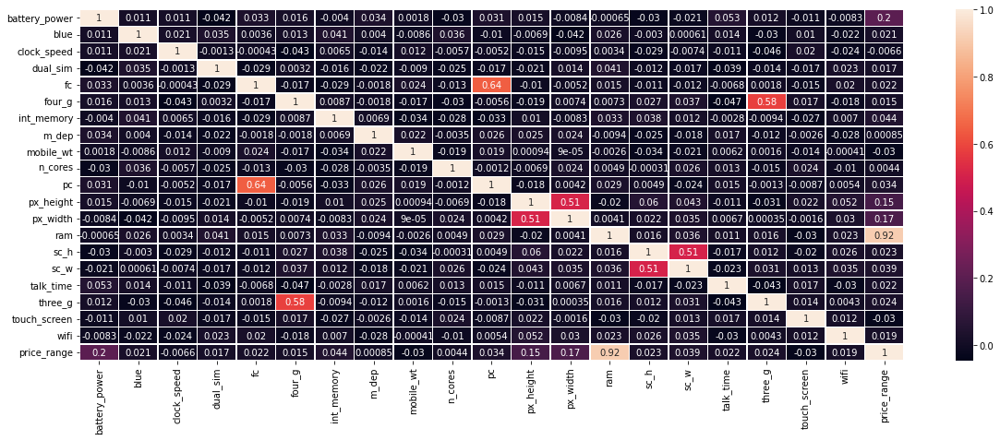

In [156]:
#heatmap to get correlation
f, ax = plt.subplots(figsize=(20, 7))
sns.heatmap(df.corr(), annot=True, linewidths=.5, ax=ax)

In [157]:
# Perform Statistical Test to obtain P-Value
#considering alpha=0.05
data1=df['sc_h'].values
data2=df['sc_w'].values

In [158]:
#lets do a correlation test so import pearson's correlation coefficient
from scipy.stats import pearsonr
stat,p=pearsonr(data1,data2)
print('stat=%.3f,p=%.3f'%(stat,p))
if p>0.05:
  print('Since p value is more than alpha, we failed to reject null hypothesis,So it is right to say that the two samples are independent or there is no correlation between them')
else:
  print('Since p value is less than alpha, we can reject the null hypothesis and it is right to say that there is a dependency between the sample and have a correlation between them ')

stat=0.506,p=0.000
Since p value is less than alpha, we can reject the null hypothesis and it is right to say that there is a dependency between the sample and have a correlation between them 


##### Which statistical test have you done to obtain P-Value?

I have used correlation test (Pearson's correlation coefficient) to get the p value.

##### Why did you choose the specific statistical test?

Pearson's correlation coefficient is the test statistics that measures the statistical relationship, or association, between two continuous variables. It is known as the best method of measuring the association between variables of interest because it is based on the method of covariance.


### Hypothetical Statement - 3

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

Null Hypothesis

H0: the sample has a Gaussian distribution.

Alternate Hpothesis

Ha: the sample does not have a Gaussian distribution.

#### 2. Perform an appropriate statistical test.

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


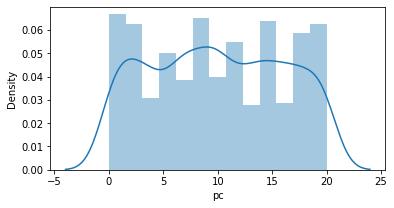

In [159]:
#lets show the required columns distribution
sns.distplot(data['pc'])

In [160]:
# Perform Statistical Test to obtain P-Value
#considering the value of alpha=0.05
#import normaltest to get p value from scipy
from scipy.stats import normaltest
data1=data['pc'].values
stat,p=normaltest(data1)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
 print('Since p value is more than alpha, we failed to reject null hypothesis,So it is right to say that it is Probably Gaussian')
else:
 print('Since p value is less than alpha, we can reject the null hypothesis and it is right to say that it is Probably not Gaussian')

stat=1276.480, p=0.000
Since p value is less than alpha, we can reject the null hypothesis and it is right to say that it is Probably not Gaussian


##### Which statistical test have you done to obtain P-Value?

I have used D’Agostino’s K^2 Test to get the p value.

##### Why did you choose the specific statistical test?

The D'Agostino-Pearson test checks if the shape of the distribution is similar to the shape of the normal distribution. This is a combination of the skewness test and the kurtosis test. The D'Agostino-Pearson is not the most powerful test, but you may use it for any distribution.

### 1. Which Evaluation metrics did you consider for a positive business impact and why?

I have used the accuracy score as evaluation metrics for each model applied to the dataset because the Accuracy score (or just Accuracy) is a Classification metric featuring a fraction of the predictions that a model got right. The metric is prevalent as it is easy to calculate and interpret. Also, it measures the model's performance with a single value.

### 2. Which ML model did you choose from the above created models as your final prediction model and why?

I choosed Logistic regresson with hyper tunning to be the best machine learning model out of other models as it gives the high accuracy score for both training data and testing data. If i talk about its accuracy percentage then its training accuracy score is found to be 95.625% and its testing accuracy score to be 94%.

### 3. Explain the model which you have used and the feature importance using any model explainability tool?

#Model Explainability using LIME

In [162]:
pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 275 kB 4.5 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=e0848c4cb2455b9d1e4db3ec70dbe3cc22f5c6e1c09acb18fa5712f0da84d06b
  Stored in directory: /root/.cache/pip/wheels/e6/a6/20/cc1e293fcdb67ede666fed293cb895395e7ecceb4467779546
Successfully built lime


In [163]:
#importing lime and its function
import lime
import lime.lime_tabular

In [164]:
#Calling the LIME tabular explainer
explainer = lime.lime_tabular.LimeTabularExplainer(x_train, feature_names=x, class_names=y.unique(), discretize_continuous=True)

In [165]:
#Showing model features and its importance at various instances
for j in [5,17,49,120]:
  exp = explainer.explain_instance(x_test[8],logmodel_cv.predict_proba,num_features=4,top_labels=1)
  print('for value of j :',j)
  exp.show_in_notebook(show_table=True)

for value of j : 5


for value of j : 17


for value of j : 49


for value of j : 120


## ***8.*** ***Future Work (Optional)***

### 1. Save the best performing ml model in a pickle file or joblib file format for deployment process.


In [166]:
# Save the File
import pickle
pickle.dump(logmodel_cv,open('model.pkl','wb'))

### 2. Again Load the saved model file and try to predict unseen data for a sanity check.


In [167]:
# Load the File and predict unseen data.
pickled_model = pickle.load(open('model.pkl', 'rb'))
pickled_model.predict(x_test)

array([3, 2, 0, 2, 3, 2, 0, 0, 1, 0, 3, 0, 0, 1, 3, 3, 2, 0, 1, 3, 1, 0,
       3, 2, 2, 1, 1, 0, 2, 1, 1, 2, 0, 2, 2, 3, 0, 3, 1, 0, 2, 0, 0, 2,
       3, 0, 3, 3, 2, 1, 0, 3, 0, 2, 0, 3, 3, 0, 2, 1, 1, 2, 3, 1, 1, 0,
       0, 1, 3, 3, 3, 2, 1, 1, 2, 0, 2, 3, 1, 2, 3, 2, 2, 0, 0, 1, 0, 0,
       0, 1, 0, 2, 2, 3, 0, 3, 0, 0, 2, 2, 3, 1, 1, 0, 3, 3, 1, 2, 1, 1,
       0, 2, 3, 1, 3, 2, 2, 2, 2, 2, 2, 0, 3, 0, 3, 3, 2, 1, 2, 3, 3, 0,
       0, 1, 3, 1, 2, 3, 2, 3, 3, 3, 2, 1, 3, 3, 1, 1, 0, 1, 3, 0, 1, 0,
       3, 3, 3, 3, 0, 2, 2, 0, 0, 3, 1, 1, 3, 1, 3, 0, 1, 1, 1, 3, 2, 1,
       1, 3, 0, 3, 2, 2, 2, 3, 0, 2, 0, 1, 1, 1, 0, 2, 1, 2, 3, 0, 2, 3,
       1, 1, 1, 2, 1, 3, 0, 0, 3, 1, 2, 2, 0, 3, 2, 0, 0, 3, 1, 2, 3, 3,
       0, 3, 3, 2, 2, 1, 2, 2, 1, 1, 0, 2, 0, 0, 0, 0, 0, 2, 1, 2, 2, 3,
       0, 1, 3, 2, 2, 3, 3, 2, 1, 0, 3, 3, 1, 3, 2, 2, 2, 2, 2, 2, 3, 1,
       0, 0, 3, 1, 2, 3, 3, 0, 0, 0, 1, 3, 2, 2, 3, 1, 3, 2, 2, 1, 1, 0,
       1, 1, 2, 3, 1, 0, 3, 1, 1, 1, 0, 1, 1, 1, 1,

### ***Hurrah! our model is successfully created and ready for deployment on a live server for a real user interaction !!!***

# **Conclusion**

1) From EDA we can see that here are mobile phones in 4 price ranges. The number of elements is almost similar.

2) Half the devices have Bluetooth, and half don’t

3) There is a gradual increase in battery as the price range increases

4) Ram has continuous increase with price range while moving from Low cost to Very high cost

5) Costly phones are lighter

6) RAM, battery power, pixels played more significant role in deciding the price range of mobile phone.

7) From all of the above machine learning modelling, we can conclude that logistic regression with hyperparameters and the support vector machine are the best performing models having an accuracy of 94% and 92.25%

#...............................THANK YOU........................